In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from scipy.spatial.distance import pdist, squareform
import community as community_louvain
from networkx.algorithms import community
import igraph as ig
from igraph import Graph, plot
import networkx as nx
import cairocffi
import igraph
#from igraph import *
import random
from scipy import stats
from scipy.stats import pearsonr, spearmanr
from scipy.cluster.hierarchy import linkage, dendrogram
from matplotlib.lines import Line2D
from PIL import Image
import itertools
from scipy.stats import pearsonr, linregress
from sklearn.manifold import MDS
from scipy.linalg import eigh

Load data

In [2]:
# otu table
ecdata = pd.read_csv("otu.csv", index_col="EC")
ecdata = ecdata.drop(columns=["prt_read_lenght_av"])

# pathways table
pathways_df = pd.read_csv('Carbon_EC_numbers - Pathways_overlap.csv')
ec_c_fixation_df = pathways_df[pathways_df['pathway'].isin(['3HBC', 'CBB', 'DCHB', 'HPHB', 'rTCA', 'WL'])]
ec_list = pathways_df.EC.values.flatten() #List of all C related ECs
ec_c_fixation_list = ec_c_fixation_df.EC.values.flatten() #List of C-fixation related ECs

# env table
envdata = pd.read_csv("env.csv", index_col="rowname")



#ADDED on 20241010: i joint the otu from Fullerton
ecdata_fullerton = pd.read_csv("mifaser_dataset_from_Fullerton.csv", index_col="EC").drop(ecdata_fullerton.columns[0], axis=1)
merged_df = pd.concat([ecdata, ecdata_fullerton], axis=1, join='outer')
ecdata = merged_df

Prevalence analysis (first with sum of abundance / second with mean abundance)

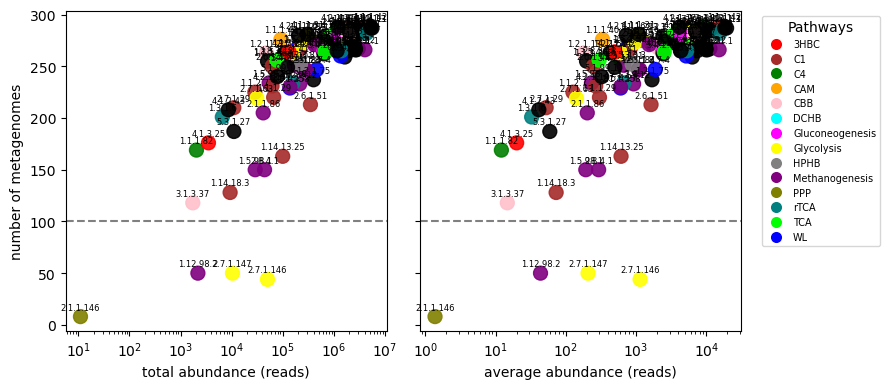

In [3]:
tested_df = ecdata.loc[ecdata.index.isin(ec_list)]

# Calculate prevalence
prevalence = (tested_df > 0).sum(axis=1)

# Calculate average and sum of abundances
filtered_ecdata = tested_df[tested_df > 0]
average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
sum_abundance = filtered_ecdata.sum(axis=1)

# Define a specific color for each pathway
pathway_colors = {
    '3HBC': 'red',
    'C1': 'brown',
    'C4': 'green',
    'CAM': 'orange',
    'CBB': 'pink',
    'DCHB': 'cyan',
    'Gluconeogenesis': 'magenta',
    'Glycolysis': 'yellow',
    'HPHB': 'gray',
    'Methanogenesis': 'purple',
    'PPP': 'olive',
    'rTCA': 'teal',
    'TCA': 'lime',
    'WL': 'blue'
}

# Create a dictionary to map EC numbers to colors
ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
               for ec, pathways in ec_to_pathway.items()}

# Map EC numbers to colors
colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

# Create the figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Plot 1: Average abundance
scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
ax1.axhline(y=100, color='gray', linestyle='--')
ax1.set_xlabel('total abundance (reads)')
ax1.set_xscale('log')
ax1.set_ylabel('number of metagenomes')

# Plot 2: Sum of abundances
scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
ax2.axhline(y=100, color='gray', linestyle='--')
ax2.set_xlabel('average abundance (reads)')
ax2.set_xscale('log')
ax2.set_yticklabels([])
#ax2.set_ylabel('number of metagenomes')

# Add legend to the second plot
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
           for color in pathway_colors.values()]
ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

# Annotate dots with EC numbers on both plots
for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
    ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
    ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

plt.tight_layout()
plt.show()

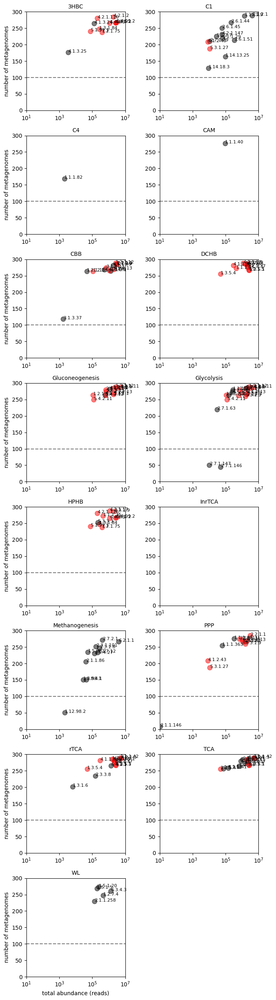

In [4]:
# Merge ecdata with pathways_df based on EC numbers
merged_df = pd.merge(pathways_df, ecdata, left_on='EC', right_index=True, how='right')

# Group by pathways
grouped_pathways = merged_df.groupby('pathway')

# Check if any EC is in more than one pathway
ec_in_multiple_pathways = pathways_df.groupby('EC').filter(lambda x: len(x) > 1)['EC'].unique()

fig, axes = plt.subplots(8, 2, figsize=(7, 25)) 
axes = axes.flatten()  # Flatten the axes array for easy iteration

# Get all pathways
all_pathways = pathways_df['pathway'].unique()

# Loop through each pathway (including empty pathways) and create the plot
for idx, (ax, pathway) in enumerate(zip(axes, all_pathways)):
    if pathway in grouped_pathways.groups:
        group = grouped_pathways.get_group(pathway)

        # Drop 'pathway' and 'EC' columns to get only abundance data
        abundance_data = group.drop(columns=['pathway', 'EC'])

        # Ensure only numeric columns are selected (abundance data should be numeric)
        abundance_data = abundance_data.apply(pd.to_numeric, errors='coerce')

        # Calculate the prevalence (number of metagenomes where abundance > 0) for each EC number
        prevalence = (abundance_data > 0).sum(axis=1)

        # Calculate the total abundance for each EC number
        total_abundance = abundance_data.sum(axis=1)

        # Plotting with special color for EC numbers in multiple pathways
        colors = ['red' if ec in ec_in_multiple_pathways else 'black' for ec in group['EC']]
        ax.scatter(total_abundance, prevalence, color=colors, alpha=0.5, s=70)

        ax.axhline(y=100, color='gray', linestyle='--')

        # Add EC numbers as text labels next to each point
        for i, ec_number in enumerate(group['EC']):
            ax.text(total_abundance.iloc[i], prevalence.iloc[i], ec_number, fontsize=8)

    ax.set_title(f'{pathway}', fontsize=10)
    ax.grid(False)
    ax.set_xscale('log')
    ax.set_xlim(10, 10**7)
    ax.set_ylim(0, 300)

    # Set labels for only the outermost plots
    if idx % 2 == 0:  # First column
        ax.set_ylabel('number of metagenomes')
    if idx >= 14:  # Last row
        ax.set_xlabel('total abundance (reads)')

# Add empty plots if needed for pathways without EC numbers in the OTU table
for i in range(len(all_pathways), len(axes)):
    axes[i].axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()
#plt.savefig('prevalence_anal_total.png', dpi=300)

plt.show()


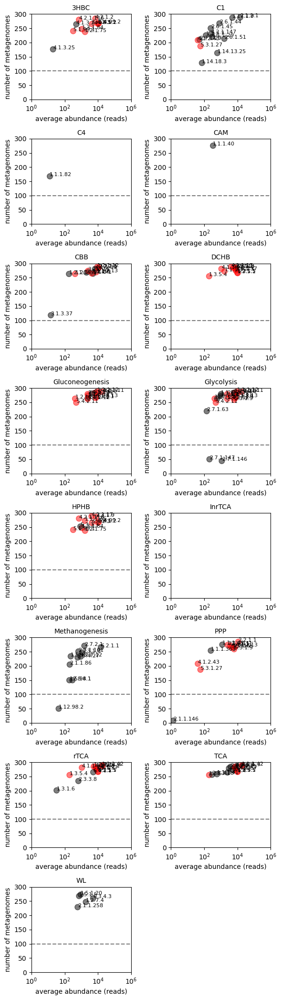

In [5]:
# Merge ecdata with pathways_df based on EC numbers
merged_df = pd.merge(pathways_df, ecdata, left_on='EC', right_index=True, how='right')

# Group by pathways
grouped_pathways = merged_df.groupby('pathway')

# Check if any EC is in more than one pathway
ec_in_multiple_pathways = pathways_df.groupby('EC').filter(lambda x: len(x) > 1)['EC'].unique()

# Set up a 7x2 grid for the subplots
fig, axes = plt.subplots(8, 2, figsize=(6, 21))  # 7 rows, 2 columns
axes = axes.flatten()  # Flatten the axes array for easy iteration

# Get all pathways
all_pathways = pathways_df['pathway'].unique()

# Loop through each pathway (including empty pathways) and create the plot
for ax, pathway in zip(axes, all_pathways):
    if pathway in grouped_pathways.groups:
        group = grouped_pathways.get_group(pathway)

        # Drop 'pathway' and 'EC' columns to get only abundance data
        abundance_data = group.drop(columns=['pathway', 'EC'])

        # Ensure only numeric columns are selected (abundance data should be numeric)
        abundance_data = abundance_data.apply(pd.to_numeric, errors='coerce')

        # Calculate the prevalence (number of metagenomes where abundance > 0) for each EC number
        prevalence = (abundance_data > 0).sum(axis=1)

        # Calculate the total abundance for each EC number
        total_abundance = abundance_data.mean(axis=1)

        # Plotting with special color for EC numbers in multiple pathways
        colors = ['red' if ec in ec_in_multiple_pathways else 'black' for ec in group['EC']]
        ax.scatter(total_abundance, prevalence, color=colors, alpha = .5, s=70)

        ax.axhline(y=100, color='gray', linestyle='--')

        # Add EC numbers as text labels next to each point
        for i, ec_number in enumerate(group['EC']):
            ax.text(total_abundance.iloc[i], prevalence.iloc[i], ec_number, fontsize=8)

    ax.set_title(f'{pathway}', fontsize=10)
    ax.grid(False)
    ax.set_xscale('log')
    ax.set_xlim(1, 10**6)
    ax.set_ylim(0, 300)

    # Set labels for only the outermost plots
    if idx % 2 == 0:  # First column
        ax.set_ylabel('number of metagenomes')
    if idx >= 14:  # Last row
        ax.set_xlabel('average abundance (reads)')

# Add empty plots if needed for pathways without EC numbers in the OTU table
for i in range(len(all_pathways), len(axes)):
    axes[i].axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()
#plt.savefig('prevalence_anal_avg.png', dpi=300)

plt.show()


Clean dataset

In [6]:
#Identified by Deborah
ecdata = ecdata.drop(ecdata.columns[[124, 122, 148, 152, 150, 139, 140, 141, 142, 143, 144, 153, 137, 138, 133, 134, 64, 76, 72, 77, 174, 175, 198, 176, 173, 232, 233, 231, 69, 67, 76, 71]], axis=1)

#Identified by me
ecdata = ecdata.drop(columns=['SAMN10130915']) #weird metagenome: Contains only a few EC

Repeat prevalence analysis

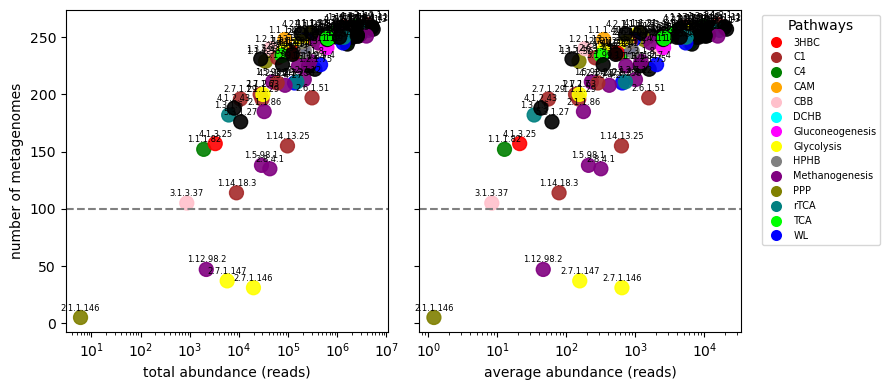

In [7]:
tested_df = ecdata.loc[ecdata.index.isin(ec_list)]

# Calculate prevalence
prevalence = (tested_df > 0).sum(axis=1)

# Calculate average and sum of abundances
filtered_ecdata = tested_df[tested_df > 0]
average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
sum_abundance = filtered_ecdata.sum(axis=1)

# Define a specific color for each pathway
pathway_colors = {
    '3HBC': 'red',
    'C1': 'brown',
    'C4': 'green',
    'CAM': 'orange',
    'CBB': 'pink',
    'DCHB': 'cyan',
    'Gluconeogenesis': 'magenta',
    'Glycolysis': 'yellow',
    'HPHB': 'gray',
    'Methanogenesis': 'purple',
    'PPP': 'olive',
    'rTCA': 'teal',
    'TCA': 'lime',
    'WL': 'blue'
}

# Create a dictionary to map EC numbers to colors
ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
               for ec, pathways in ec_to_pathway.items()}

# Map EC numbers to colors
colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

# Create the figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Plot 1: Average abundance
scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
ax1.axhline(y=100, color='gray', linestyle='--')
ax1.set_xlabel('total abundance (reads)')
ax1.set_xscale('log')
ax1.set_ylabel('number of metagenomes')

# Plot 2: Sum of abundances
scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
ax2.axhline(y=100, color='gray', linestyle='--')
ax2.set_xlabel('average abundance (reads)')
ax2.set_xscale('log')
ax2.set_yticklabels([])
#ax2.set_ylabel('number of metagenomes')

# Add legend to the second plot
handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
           for color in pathway_colors.values()]
ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

# Annotate dots with EC numbers on both plots
for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
    ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
    ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)


plt.tight_layout()
plt.show()


In [8]:
#fill NaN values with 0
#ecdata = ecdata.fillna(0)


In [9]:
ecdata

,CR18BCF,BQ170218F,BQ170218S,BQ170218,BR170218_2F,BR170218_1,BR170218_2S,CR18BSF,CR18CHF,CR18CHS,...,SAMN14653546,SAMN14653547,SAMN14653548,SAMN14653549,SAMN14653552,SAMN14653553,SAMN14653554,SAMN14653555,SAMN14653556,SAMN14653557
EC,,,,,,,,,,,,,,,,,,,,,
1.1.1.1,1175.0,8191.0,8848.0,7199.0,4631.0,1511.0,1547.0,13016.0,1548.0,1085.0,...,1967.0,1125.0,799.0,4804.0,1395.0,407.0,491.0,1088.0,1960.0,567.0
1.1.1.10,17.0,NaN,NaN,NaN,6.0,9.0,41.0,103.0,39.0,24.0,...,40.0,24.0,25.0,9.0,28.0,1.0,5.0,39.0,44.0,7.0
1.1.1.100,6054.0,4291.0,5304.0,3802.0,10787.0,11054.0,13673.0,26515.0,9391.0,7281.0,...,12076.0,6783.0,4983.0,9983.0,6694.0,2111.0,11532.0,9093.0,8131.0,4254.0
1.1.1.103,1660.0,30.0,669.0,36.0,1607.0,1962.0,3418.0,4539.0,1516.0,1672.0,...,2533.0,1344.0,1234.0,390.0,991.0,975.0,356.0,3007.0,1561.0,931.0
1.1.1.107,52.0,144.0,136.0,209.0,42.0,104.0,150.0,101.0,130.0,94.0,...,77.0,112.0,60.0,27.0,68.0,8.0,19.0,162.0,75.0,34.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7.5.2.8,486.0,NaN,87.0,NaN,412.0,31.0,144.0,2940.0,956.0,146.0,...,394.0,295.0,331.0,94.0,186.0,23.0,81.0,287.0,451.0,269.0
7.6.2.1,785.0,26.0,121.0,10.0,481.0,511.0,804.0,907.0,409.0,353.0,...,655.0,389.0,349.0,360.0,420.0,88.0,231.0,553.0,383.0,179.0
7.6.2.2,1264.0,559.0,784.0,415.0,1219.0,1320.0,2076.0,3377.0,1668.0,1251.0,...,2576.0,998.0,871.0,512.0,998.0,354.0,1655.0,1659.0,1267.0,516.0


In [10]:
#Filter only C genes from the begining 
#ecdata = ecdata.loc[ecdata.index.isin(ec_list)]
#ecdata = ecdata.loc[ecdata.index.isin(ec_c_fixation_list)]

Normalization

In [11]:
#Normalization by col_sum
ecdata_n = ecdata.apply(lambda x: (x / x.sum(skipna=True)), axis=0)

# Remove columns where ecdata.loc["2.7.7.6"] == 0 (these ones had NaN for rpo...)
ecdata_with_rpo = ecdata.loc[:, ecdata.loc["2.7.7.6"] != 0]
ecdata_n_rpo = ecdata_with_rpo.div(ecdata_with_rpo.loc["2.7.7.6"], axis=1)


Select only carbon associated genes

In [12]:

dataset_carbon = ecdata.loc[ecdata.index.isin(ec_list)]
dataset_carbon_n = ecdata_n.loc[ecdata_n.index.isin(ec_list)]
dataset_carbon_n_rpo = ecdata_n_rpo.loc[ecdata_n_rpo.index.isin(ec_list)]

# Select only carbon fixation pathways genes
#dataset_carbon = ecdata.loc[ecdata.index.isin(ec_c_fixation_list)]
#dataset_carbon_n = ecdata_n.loc[ecdata_n.index.isin(ec_c_fixation_list)]
#dataset_carbon_n_rpo = ecdata_n_rpo.loc[ecdata_n_rpo.index.isin(ec_c_fixation_list)]


Delete EC identified in the prevalence analysis

In [13]:
# List of indexes to remove
indexes_to_remove = ["2.7.1.146", "2.7.1.147", "1.12.98.2", "2.1.1.146"]

# Remove the rows with the specified indexes
dataset_carbon = dataset_carbon.drop(index=indexes_to_remove)
dataset_carbon_n = dataset_carbon_n.drop(index=indexes_to_remove)
dataset_carbon_n_rpo = dataset_carbon_n_rpo.drop(index=indexes_to_remove)


In [17]:
dataset_carbon_n_rpo.to_csv('oldtest.csv')

Repeat prevalence analysis (for all 3 datasets)

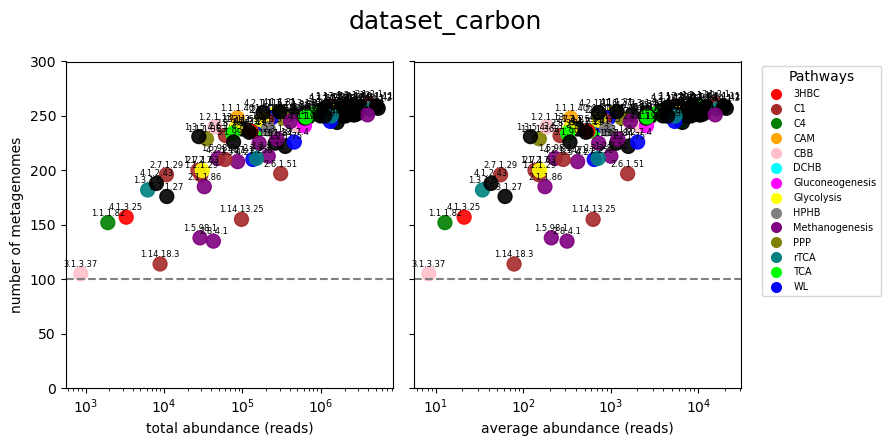

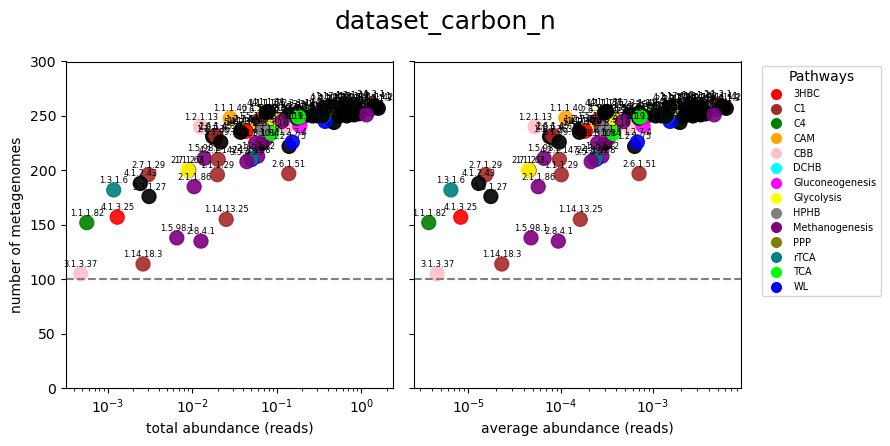

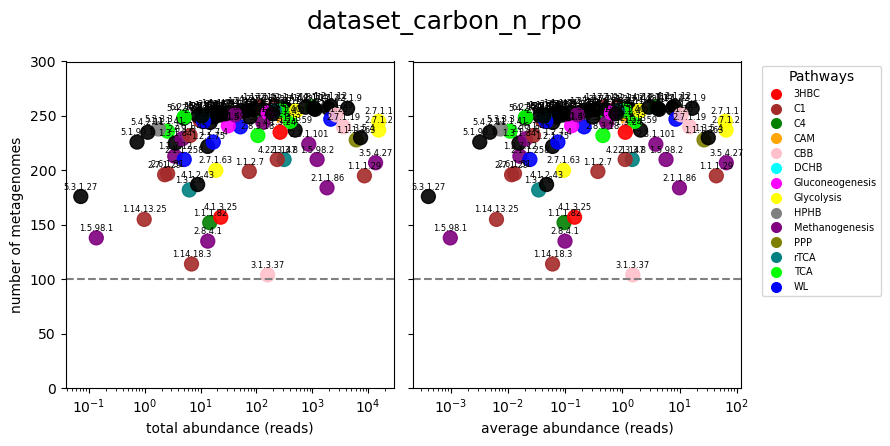

In [15]:
dataset_names = ['dataset_carbon', 'dataset_carbon_n', 'dataset_carbon_n_rpo']

# Loop through the datasets along with their names
for tested_df, dataset_name in zip([dataset_carbon, dataset_carbon_n, dataset_carbon_n_rpo], dataset_names):

    # Calculate prevalence
    prevalence = (tested_df > 0).sum(axis=1)

    # Calculate average and sum of abundances
    filtered_ecdata = tested_df[tested_df > 0]
    average_abundance = filtered_ecdata.sum(axis=1) / filtered_ecdata.count(axis=1)
    sum_abundance = filtered_ecdata.sum(axis=1)

    # Define a specific color for each pathway
    pathway_colors = {
        '3HBC': 'red',
        'C1': 'brown',
        'C4': 'green',
        'CAM': 'orange',
        'CBB': 'pink',
        'DCHB': 'cyan',
        'Gluconeogenesis': 'magenta',
        'Glycolysis': 'yellow',
        'HPHB': 'gray',
        'Methanogenesis': 'purple',
        'PPP': 'olive',
        'rTCA': 'teal',
        'TCA': 'lime',
        'WL': 'blue'
    }

    # Create a dictionary to map EC numbers to colors
    ec_to_pathway = pathways_df.groupby('EC')['pathway'].apply(lambda x: '/'.join(x))
    ec_to_color = {ec: 'black' if len(pathways.split('/')) > 1 else pathway_colors.get(pathways.split('/')[0], 'black')
                for ec, pathways in ec_to_pathway.items()}

    # Map EC numbers to colors
    colors = [ec_to_color.get(ec, 'black') for ec in tested_df.index]

    # Create the figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4.5))

    # Plot 1: Average abundance
    scatter1 = ax1.scatter(sum_abundance, prevalence, c=colors, alpha=.9, s=100)
    ax1.axhline(y=100, color='gray', linestyle='--')
    ax1.set_xlabel('total abundance (reads)')
    ax1.set_xscale('log')
    ax1.set_ylabel('number of metagenomes')

    # Plot 2: Sum of abundances
    scatter2 = ax2.scatter(average_abundance, prevalence, c=colors, alpha=.9, s=100)
    ax2.axhline(y=100, color='gray', linestyle='--')
    ax2.set_xlabel('average abundance (reads)')
    ax2.set_xscale('log')
    ax2.set_yticklabels([])
    #ax2.set_ylabel('number of metagenomes')
    ax1.set_ylim(0, 300)
    ax2.set_ylim(0, 300)

    # Add legend to the second plot
    handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=9, linestyle='') 
            for color in pathway_colors.values()]
    ax2.legend(handles, pathway_colors.keys(), title='Pathways', bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=7)

    # Annotate dots with EC numbers on both plots
    for i, (x, y, ec) in enumerate(zip(sum_abundance, prevalence, tested_df.index)):
        ax1.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)

    for i, (x, y, ec) in enumerate(zip(average_abundance, prevalence, tested_df.index)):
        ax2.annotate(ec, (x, y), textcoords="offset points", xytext=(0,5), ha='center', fontsize=6)
    
    fig.suptitle(f"{dataset_name}", fontsize=18)

    plt.tight_layout()
    plt.show()


### PCoA / nMDS of all samples

All C-related genes

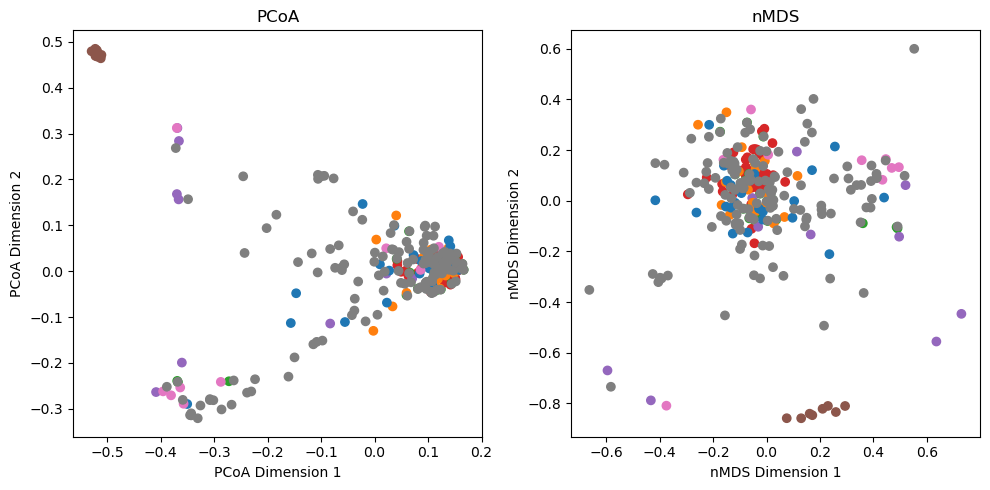

In [19]:
# Load environmental data
envdata = pd.read_csv("env.csv", index_col="rowname")

USE_ALL_DATA = True
DATASET = dataset_carbon_n
VARIABLE = "campaign"

# Filtering the data to include only carbon fixation pathways (CFP) if needed
dataset_filtered = DATASET[DATASET.index.isin(ec_c_fixation_list)] if not USE_ALL_DATA else DATASET

# Replace NaN values with 0 (or another approach if needed)
dataset_filtered = dataset_filtered.fillna(0)

# Drop rows/columns that are all zeros
dataset_filtered = dataset_filtered.loc[(dataset_filtered != 0).any(axis=1)]
dataset_filtered = dataset_filtered.loc[:, (dataset_filtered != 0).any(axis=0)]

# Calculate the Bray-Curtis dissimilarity matrix
dissimilarity_matrix = pdist(dataset_filtered.T, metric='braycurtis')
dissimilarity_matrix = squareform(dissimilarity_matrix)

# Center the dissimilarity matrix for PCoA
n = dissimilarity_matrix.shape[0]
identity_matrix = np.eye(n)
ones_matrix = np.ones((n, n)) / n
centered_matrix = -0.5 * (identity_matrix - ones_matrix) @ dissimilarity_matrix @ (identity_matrix - ones_matrix)

# Verify for NaNs or infinite values before proceeding
if np.any(np.isnan(centered_matrix)) or np.any(np.isinf(centered_matrix)):
    raise ValueError("Centered matrix contains NaN or infinity values.")

# Perform eigen decomposition
eigenvalues, eigenvectors = eigh(centered_matrix)

# Sort eigenvalues and eigenvectors in descending order
idx = eigenvalues.argsort()[::-1]
eigenvalues, eigenvectors = eigenvalues[idx], eigenvectors[:, idx]

# Keep only positive eigenvalues and corresponding eigenvectors
positive_eigenvalues = eigenvalues[eigenvalues > 0]
positive_eigenvectors = eigenvectors[:, :len(positive_eigenvalues)]

# Calculate coordinates for PCoA
pcoa_coordinates = positive_eigenvectors * np.sqrt(positive_eigenvalues)
pcoa_result = pd.DataFrame(pcoa_coordinates, columns=[f'Dim{i+1}' for i in range(pcoa_coordinates.shape[1])])

# Perform nMDS on the dissimilarity matrix
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
nmds_coordinates = mds.fit_transform(dissimilarity_matrix)
nmds_result = pd.DataFrame(nmds_coordinates, columns=['Dim1', 'Dim2'], index=dataset_filtered.columns)

# Map colors to values in the VARIABLE column
unique_values = envdata[VARIABLE].unique()
color_map = {value: color for value, color in zip(unique_values, plt.cm.tab10.colors[:len(unique_values)])}

# Create a list of colors for each sample based on the VARIABLE
colors = [color_map[envdata.loc[sample, VARIABLE]] for sample in dataset_filtered.columns]

# Plot PCoA
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.scatter(pcoa_result['Dim1'], pcoa_result['Dim2'], c=colors)
plt.xlabel('PCoA Dimension 1')
plt.ylabel('PCoA Dimension 2')
plt.title('PCoA')


# Plot nMDS
plt.subplot(1, 2, 2)
plt.scatter(nmds_result['Dim1'], nmds_result['Dim2'], c=colors)
plt.xlabel('nMDS Dimension 1')
plt.ylabel('nMDS Dimension 2')
plt.title('nMDS')




plt.tight_layout()
plt.show()


Only CFP genes

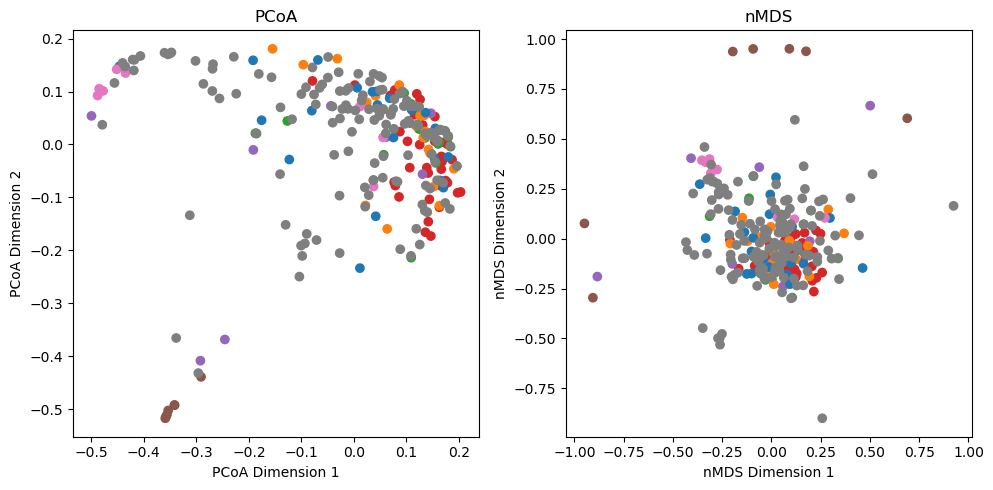

In [ ]:
# Load environmental data
envdata = pd.read_csv("env.csv", index_col="rowname")

USE_ALL_DATA = False
DATASET = dataset_carbon_n_rpo
VARIABLE = "campaign"

# Filtering the data to include only carbon fixation pathways (CFP) if needed
dataset_filtered = DATASET[DATASET.index.isin(ec_c_fixation_list)] if not USE_ALL_DATA else DATASET

# Replace NaN values with 0 (or another approach if needed)
dataset_filtered = dataset_filtered.fillna(0)

# Drop rows/columns that are all zeros
dataset_filtered = dataset_filtered.loc[(dataset_filtered != 0).any(axis=1)]
dataset_filtered = dataset_filtered.loc[:, (dataset_filtered != 0).any(axis=0)]


# Calculate the Bray-Curtis dissimilarity matrix
dissimilarity_matrix = pdist(dataset_filtered.T, metric='braycurtis')
dissimilarity_matrix = squareform(dissimilarity_matrix)

# Check for NaNs or infinite values in the dissimilarity matrix
if np.any(np.isnan(dissimilarity_matrix)) or np.any(np.isinf(dissimilarity_matrix)):
    raise ValueError("Dissimilarity matrix contains NaN or infinity values.")

# Center the dissimilarity matrix for PCoA
n = dissimilarity_matrix.shape[0]
identity_matrix = np.eye(n)
ones_matrix = np.ones((n, n)) / n
centered_matrix = -0.5 * (identity_matrix - ones_matrix) @ dissimilarity_matrix @ (identity_matrix - ones_matrix)

# Verify for NaNs or infinite values before proceeding
if np.any(np.isnan(centered_matrix)) or np.any(np.isinf(centered_matrix)):
    raise ValueError("Centered matrix contains NaN or infinity values.")

# Perform eigen decomposition
eigenvalues, eigenvectors = eigh(centered_matrix)

# Sort eigenvalues and eigenvectors in descending order
idx = eigenvalues.argsort()[::-1]
eigenvalues, eigenvectors = eigenvalues[idx], eigenvectors[:, idx]

# Keep only positive eigenvalues and corresponding eigenvectors
positive_eigenvalues = eigenvalues[eigenvalues > 0]
positive_eigenvectors = eigenvectors[:, :len(positive_eigenvalues)]

# Calculate coordinates for PCoA
pcoa_coordinates = positive_eigenvectors * np.sqrt(positive_eigenvalues)
pcoa_result = pd.DataFrame(pcoa_coordinates, columns=[f'Dim{i+1}' for i in range(pcoa_coordinates.shape[1])])

# Perform nMDS on the dissimilarity matrix
mds = MDS(n_components=2, dissimilarity='precomputed', random_state=42)
nmds_coordinates = mds.fit_transform(dissimilarity_matrix)
nmds_result = pd.DataFrame(nmds_coordinates, columns=['Dim1', 'Dim2'], index=dataset_filtered.columns)

# Map colors to values in the VARIABLE column
unique_values = envdata[VARIABLE].unique()
color_map = {value: color for value, color in zip(unique_values, plt.cm.tab10.colors[:len(unique_values)])}

# Create a list of colors for each sample based on the VARIABLE
colors = [color_map[envdata.loc[sample, VARIABLE]] for sample in dataset_filtered.columns]

# Plot PCoA
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.scatter(pcoa_result['Dim1'], pcoa_result['Dim2'], c=colors)
plt.xlabel('PCoA Dimension 1')
plt.ylabel('PCoA Dimension 2')
plt.title('PCoA')


# Plot nMDS
plt.subplot(1, 2, 2)
plt.scatter(nmds_result['Dim1'], nmds_result['Dim2'], c=colors)
plt.xlabel('nMDS Dimension 1')
plt.ylabel('nMDS Dimension 2')
plt.title('nMDS')


# Add legend for the color mapping
for value, color in color_map.items():
    plt.scatter([], [], c=[color], label=value)  # Empty scatter for legend entry
plt.legend(title=VARIABLE)


plt.tight_layout()
plt.show()


Co-occurence heatmaps

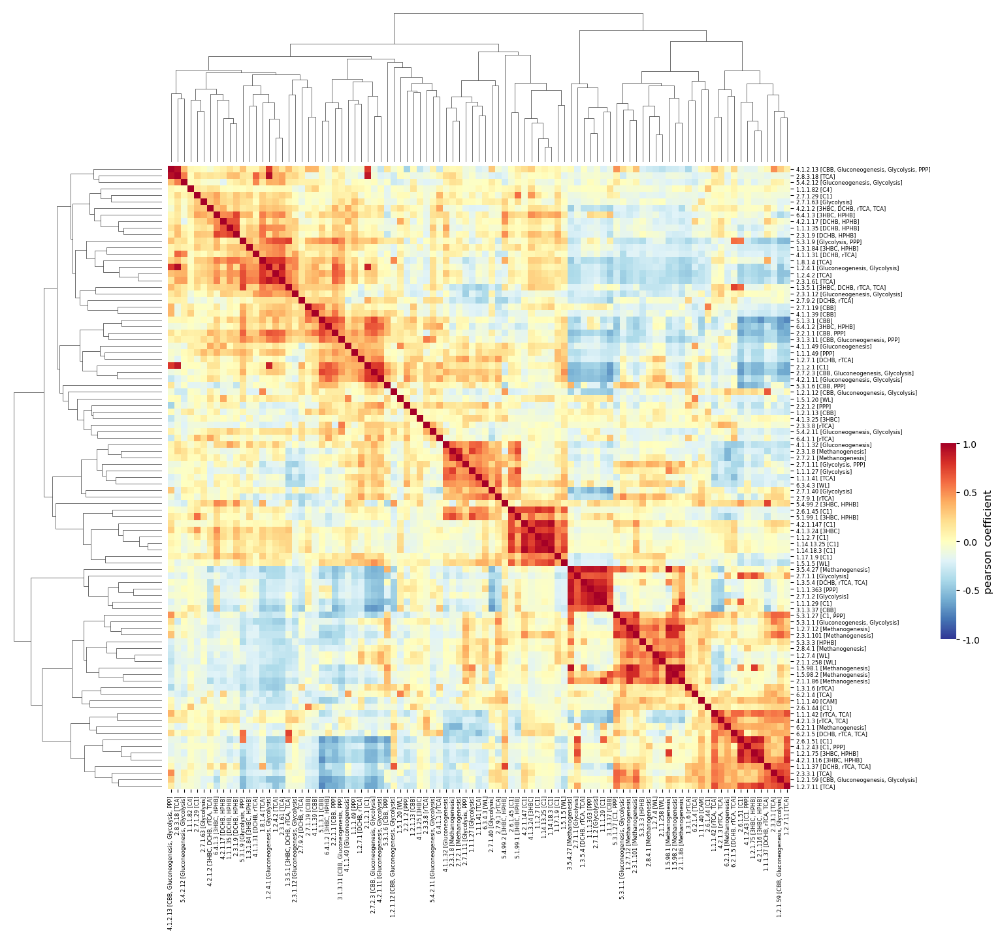

In [20]:

# Calculate Pearson correlation between rows
correlation_matrix = dataset_carbon_n.T.corr(method='pearson')

# Function to get pathways for each EC number
def get_ec_pathways(ec_number, pathways_df):
    pathways = pathways_df[pathways_df['EC'] == ec_number]['pathway'].unique()
    return f"{ec_number} [{', '.join(pathways)}]"

# Create a list of labels with EC numbers and their associated pathways
labels_with_pathways = [get_ec_pathways(ec, pathways_df) for ec in dataset_carbon_n.index]



# Create a clustermap using seaborn with bwr colormap
g = sns.clustermap(correlation_matrix, cmap='RdYlBu_r', 
                   xticklabels=labels_with_pathways, yticklabels=labels_with_pathways, 
                   method='average', metric='euclidean', cbar_pos=(0.73, 0.5, 0.012, 0.15),
                   vmin=-1, vmax=1)

# figure size
g.fig.set_size_inches(20, 20)

# label font size
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=6)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=6)

# Set colorbar label
g.cax.set_ylabel('pearson coefficient', fontsize=12)

# Customize colorbar ticks and format
cbar = g.cax
cbar.set_yticks([-1, -0.5, 0, 0.5, 1]) 
cbar.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.1f}')) 

# Remove axis titles
g.ax_heatmap.set_xlabel('')
g.ax_heatmap.set_ylabel('')

plt.show()


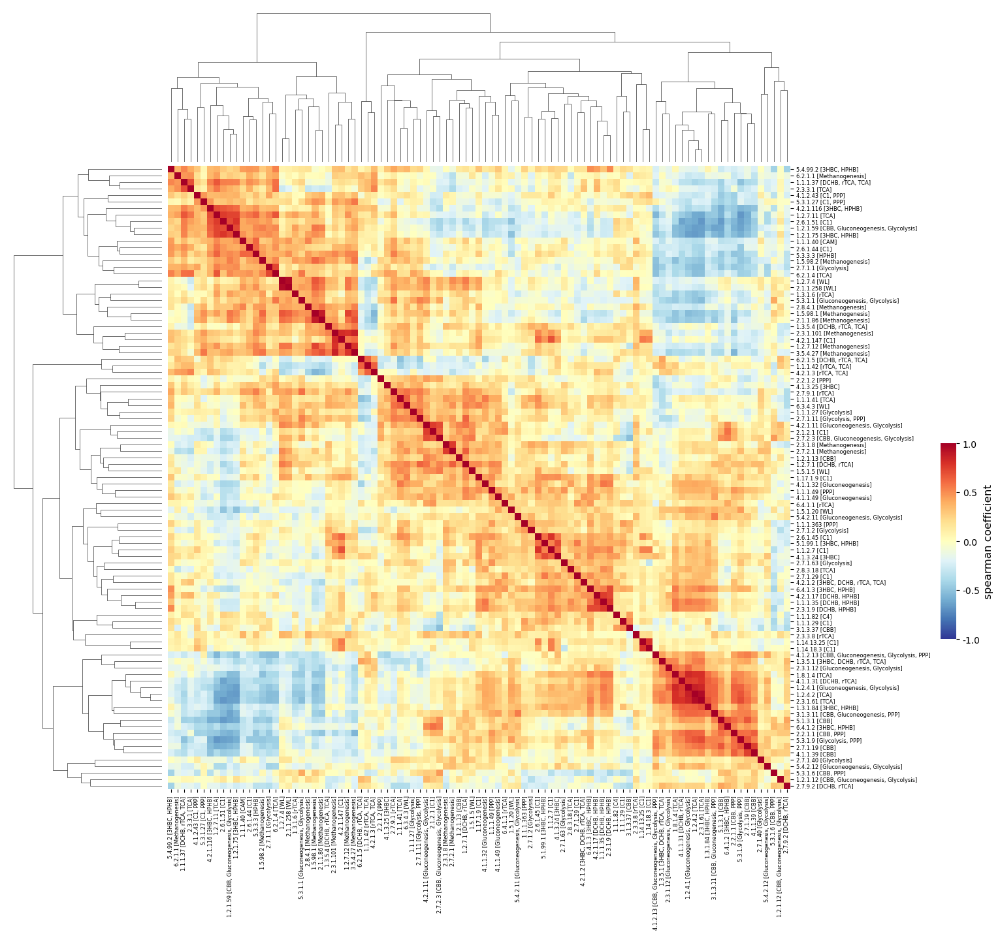

In [246]:

# Calculate spearman correlation between rows
correlation_matrix = dataset_carbon_n.T.corr(method='spearman')

# Function to get pathways for each EC number
def get_ec_pathways(ec_number, pathways_df):
    pathways = pathways_df[pathways_df['EC'] == ec_number]['pathway'].unique()
    return f"{ec_number} [{', '.join(pathways)}]"

# Create a list of labels with EC numbers and their associated pathways
labels_with_pathways = [get_ec_pathways(ec, pathways_df) for ec in dataset_carbon_n.index]



# Create a clustermap using seaborn with bwr colormap
g = sns.clustermap(correlation_matrix, cmap='RdYlBu_r', 
                   xticklabels=labels_with_pathways, yticklabels=labels_with_pathways, 
                   method='average', metric='euclidean', cbar_pos=(0.73, 0.5, 0.012, 0.15),
                   vmin=-1, vmax=1)

# figure size
g.fig.set_size_inches(20, 20)

# label font size
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), fontsize=6)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(), fontsize=6)

# Set colorbar label
g.cax.set_ylabel('spearman coefficient', fontsize=12)

# Customize colorbar ticks and format
cbar = g.cax
cbar.set_yticks([-1, -0.5, 0, 0.5, 1]) 
cbar.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.1f}')) 

# Remove axis titles
g.ax_heatmap.set_xlabel('')
g.ax_heatmap.set_ylabel('')

plt.show()


/var/folders/xd/tzd66fkj5s5676432q_qccqr0000gn/T/ipykernel_72832/2806647927.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Pathway', y='Pearson Coefficient', data=df_plot, palette='Set3', boxprops={'alpha':0.6}, showfliers=False)


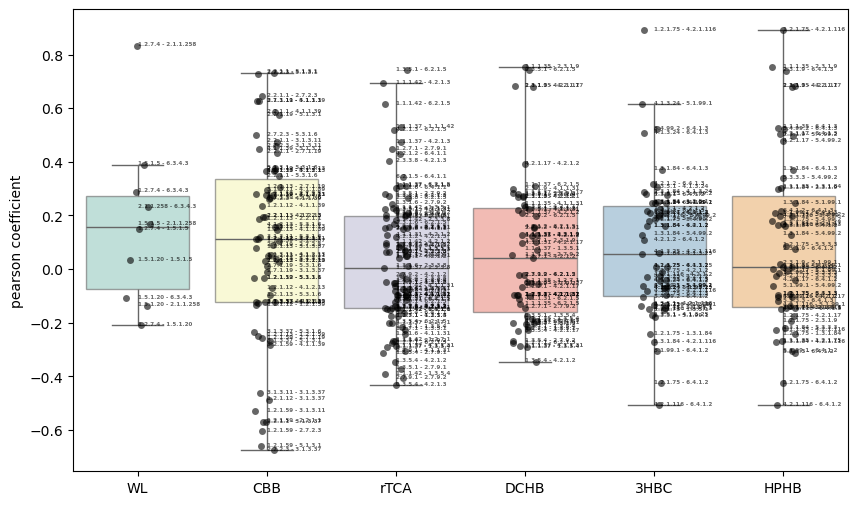

In [247]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate Pearson correlation on the original dataset
correlation_matrix = dataset_carbon_n.T.corr(method='pearson')

# List of pathways to analyze
pathways_to_analyze = ['WL', 'CBB', 'rTCA', 'DCHB', '3HBC', 'HPHB']

# Initialize a list to store the correlation values for each pathway
data_for_plot = []

# Extract EC numbers and calculate Pearson values for each pathway
for pathway in pathways_to_analyze:
    # Get EC numbers associated with the current pathway
    ec_numbers = pathways_df[pathways_df['pathway'] == pathway]['EC'].unique()
    
    # Filter out EC numbers that are not in the dataset
    ec_numbers = [ec for ec in ec_numbers if ec in correlation_matrix.index]
    
    # Get the Pearson correlation values for EC numbers in this pathway
    for i, ec1 in enumerate(ec_numbers):
        for ec2 in ec_numbers[i+1:]:
            # Take the Pearson correlation between the two EC numbers
            correlation_value = correlation_matrix.loc[ec1, ec2]
            
            # Append the result with the pathway name and EC pair
            data_for_plot.append({'Pathway': pathway, 
                                  'Pearson Coefficient': correlation_value,
                                  'EC Pair': f"{ec1} - {ec2}"})

# Convert the data into a DataFrame
df_plot = pd.DataFrame(data_for_plot)

# Create the box plot with scatter dots overlapping the boxes
plt.figure(figsize=(10, 6))
sns.boxplot(x='Pathway', y='Pearson Coefficient', data=df_plot, palette='Set3', boxprops={'alpha':0.6}, showfliers=False)
sns.stripplot(x='Pathway', y='Pearson Coefficient', data=df_plot, color='black', jitter=True, alpha=0.6)

# Add labels to the dots
for i in range(len(df_plot)):
    plt.text(df_plot['Pathway'].iloc[i], df_plot['Pearson Coefficient'].iloc[i], 
             df_plot['EC Pair'].iloc[i], 
             horizontalalignment='left', 
             size=4, 
             color='black', 
             weight='semibold', 
             alpha=0.6)


plt.xlabel('')
plt.ylabel('pearson coefficient')

#plt.savefig('prevalence_per_pathway_pearson.pdf', dpi=300)
plt.show()


In [248]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate Pearson correlation on the original dataset
correlation_matrix = dataset_carbon_n.T.corr(method='pearson')

# List of pathways to analyze
pathways_to_analyze = ['WL', 'CBB', 'rTCA', 'DHCB', '3HBC', 'HPHB']

# Initialize a list to store the correlation values for each pathway
data_for_plot = []

# Extract EC numbers and calculate Pearson values for each pathway
for pathway in pathways_to_analyze:
    # Get EC numbers associated with the current pathway
    ec_numbers = pathways_df[pathways_df['pathway'] == pathway]['EC'].unique()
    
    # Filter out EC numbers that are not in the dataset
    ec_numbers = [ec for ec in ec_numbers if ec in correlation_matrix.index]
    
    # Get the Pearson correlation values for EC numbers in this pathway
    for i, ec1 in enumerate(ec_numbers):
        for ec2 in ec_numbers[i+1:]:
            # Take the Pearson correlation between the two EC numbers
            correlation_value = correlation_matrix.loc[ec1, ec2]
            
            # Append the result with the pathway name and EC pair
            data_for_plot.append({'Pathway': pathway, 
                                  'Pearson Coefficient': correlation_value,
                                  'EC Pair': f"{ec1} - {ec2}"})

# Convert the data into a DataFrame
df_plot = pd.DataFrame(data_for_plot)

# Save the dataframe to a CSV file
#df_plot.to_csv('pearson_correlation_per_pathway.csv', index=False)


/var/folders/xd/tzd66fkj5s5676432q_qccqr0000gn/T/ipykernel_72832/1070062891.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='Pathway', y='Pearson Coefficient', data=df_plot, palette='Set3', boxprops={'alpha':0.6}, showfliers=False)


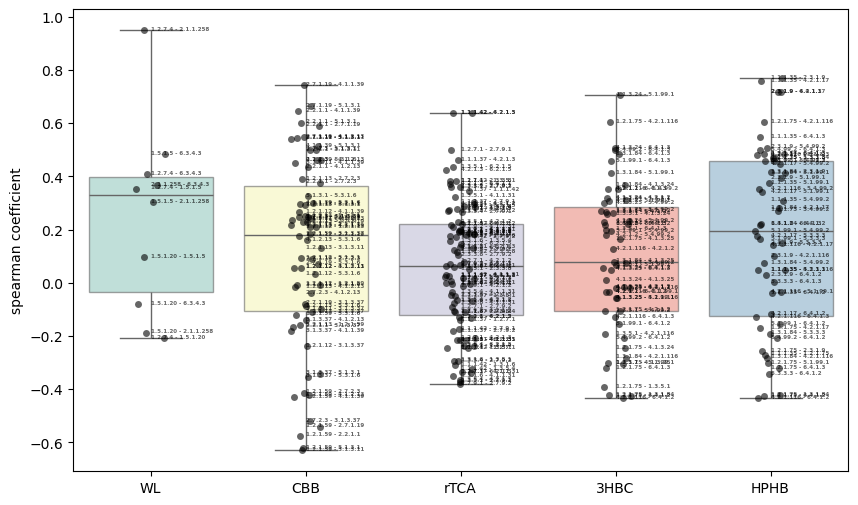

In [249]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Calculate Spearman correlation on the original dataset
correlation_matrix = dataset_carbon_n.T.corr(method='spearman')

# List of pathways to analyze
pathways_to_analyze = ['WL', 'CBB', 'rTCA', 'DHCB', '3HBC', 'HPHB']

# Initialize a list to store the correlation values for each pathway
data_for_plot = []

# Extract EC numbers and calculate Pearson values for each pathway
for pathway in pathways_to_analyze:
    # Get EC numbers associated with the current pathway
    ec_numbers = pathways_df[pathways_df['pathway'] == pathway]['EC'].unique()
    
    # Filter out EC numbers that are not in the dataset
    ec_numbers = [ec for ec in ec_numbers if ec in correlation_matrix.index]
    
    # Get the Pearson correlation values for EC numbers in this pathway
    for i, ec1 in enumerate(ec_numbers):
        for ec2 in ec_numbers[i+1:]:
            # Take the Pearson correlation between the two EC numbers
            correlation_value = correlation_matrix.loc[ec1, ec2]
            
            # Append the result with the pathway name and EC pair
            data_for_plot.append({'Pathway': pathway, 
                                  'Pearson Coefficient': correlation_value,
                                  'EC Pair': f"{ec1} - {ec2}"})

# Convert the data into a DataFrame
df_plot = pd.DataFrame(data_for_plot)

# Create the box plot with scatter dots overlapping the boxes
plt.figure(figsize=(10, 6))
sns.boxplot(x='Pathway', y='Pearson Coefficient', data=df_plot, palette='Set3', boxprops={'alpha':0.6}, showfliers=False)
sns.stripplot(x='Pathway', y='Pearson Coefficient', data=df_plot, color='black', jitter=True, alpha=0.6)

# Add labels to the dots
for i in range(len(df_plot)):
    plt.text(df_plot['Pathway'].iloc[i], df_plot['Pearson Coefficient'].iloc[i], 
             df_plot['EC Pair'].iloc[i], 
             horizontalalignment='left', 
             size=4, 
             color='black', 
             weight='semibold', 
             alpha=0.6)


plt.xlabel('')
plt.ylabel('spearman coefficient')

#plt.savefig('prevalence_per_pathway_spearman.pdf', dpi=300)
plt.show()


Definition of key ECs

In [20]:

## CBB
prk = "2.7.1.19"
rbc = "4.1.1.39"

gapn = "1.2.1.13" # according to KEGG is exclusive... and appear also high in plot #I checked and it seems indeed to be exclusive #and it is different to gapdh
sbpase = "3.1.3.37" #according to KEGG is exclusive... but appear low in the plot!!! #I checked and it seems indeed to be exclusive

## some also appears highly in correlation with these 2
#(pgk = "2.7.2.3" according to plot BUT also in other pathways... (only NGG?))
#(tkt = "2.2.1.1" according to plot BUT also in other pathways...)
#(fbp = "3.1.3.11" according to plot BUT also in other pathways...)
#(rpi = "5.3.1.6" according to plot BUT also in other pathways...)
#(fba = "4.1.2.13" according to plot BUT also in other pathways...)
#(gapdh = "1.2.1.12" according to plot BUT also in other pathways...)

#(rpe = "5.1.3.1" according to KEGG is exclusive... and appear also high in plot #I checked and IT IS WRONG: IT ALSO APPEARS IN PPP for KEGG so I think we did a mistake when filling the excel sheet)

CBB = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc])]
CBB_2 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc, gapn])]
CBB_3 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc, gapn, sbpase])]

col_sums_CBB = CBB.sum(axis=0)
col_sums_CBB_2 = CBB_2.sum(axis=0)
col_sums_CBB_3 = CBB_3.sum(axis=0)



## rTCA  

#TCA -> rTCA
# citrate synthase (2.3.3.1) -> citrate lyase (2.3.3.8) (specific of rTCA vs TCA BUT present in other ones [not so sure actually]) 
#                               (or also citryl-CoA lyase (4.1.3.34) + citryl-CoA synthetase (6.2.1.18))
# succinate dehydrogenase (1.3.99.1?? OBSOLETE! NOW 1.3.5.1) -> fumarate reductase (1.3.5.4 BUT also present in anaerobic resp) 
#                                                               (also 1.3.1.6 according to EC list? - and this one is exclusive!)
# α-ketoglutarate dehydrogenase (1.2.4.2) -> α-ketoglutarate synthase (1.2.7.3 - but present in BOTH TCA and rTCA?!)


acly = "2.3.3.8" # according to Fullerton
# ccl = "4.1.3.34" # according to above # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
# ccs = "6.2.1.18" # according to above # FOUND IN FULLERTON BUT NOT IN DEBORAH'S

frd = "1.3.5.1" #according to Simkus (but also in the TCA cycle)
frd2 = "1.3.1.6" # according to above seems more exclusive than 1.3.5.1

# kor = "1.2.7.3" # according to above but present in BOTH TCA and rTCA?! # FOUND IN FULLERTON BUT NOT IN DEBORAH'S

#FROM THE PLOT
#(suc = "6.2.1.5" according to plot BUT also in many other pathways...)
#(idh = "1.1.1.42" according to plot BUT also in other pathways...)
#(aco = "4.2.1.3" according to plot BUT also in many other pathways...)
#(mdh = "1.1.1.37" according to plot BUT also in many other pathways...)
#(por = "1.2.7.1" according to plot BUT also in other pathways...) (and it is a bad one i think)
#(ppdk = "2.7.9.1" according to plot BUT also in other pathways...) (and it is a bad one i think)
#(pyc = "6.4.1.1" according to plot BUT also in other pathways...)
#(ppsA = "2.7.9.2" according to plot BUT also in other pathways...)


#4.2.1.2 is bad

rTCA = dataset_carbon_n.loc[dataset_carbon_n.index.isin([acly, frd2])]
rTCA_2 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([acly, frd2, frd])]

col_sums_rTCA = rTCA.sum(axis=0)
col_sums_rTCA_2 = rTCA_2.sum(axis=0)




#WL
codh = "1.2.7.4"
fdh = "1.17.1.10" # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
mcr = "2.8.4.1" #???? THAT's ACCORDING TO FULLERTON.. BUT ACCORDING TO KEGG it is associated with methanogenesis!!

MeTr = "2.1.1.258" # according to plot (and exclusive to WL)

mthfr = "1.5.1.20" # BAD according to plot (but seems exclusive to WL...)

fhs = "6.3.4.3" #according to Simkus
folD = "1.5.1.5" #according to Simkus
folD2 = "3.5.4.9" #according to Simkus



WL = dataset_carbon_n.loc[dataset_carbon_n.index.isin([codh, MeTr, fhs, folD])]
WL_2 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([codh, MeTr, fhs, folD, mthfr])]
# SEE IF WE SHOULD TRY TO INCLUDE mcr

col_sums_WL = WL.sum(axis=0)
col_sums_WL_2 = WL_2.sum(axis=0)




#HB (also called 3HBC and 3HP?)
smt = "2.8.3.-" #according to Simkus # also according to KEGG (exclusive) #but not found in any mifaser
mct = "5.4.1.3" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
meh = "4.2.1.153" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
meh2 = "4.2.1.148" #according to Simkus # also according to KEGG (exclusive) # FOUND IN FULLERTON BUT NOT IN DEBORAH'S
smtab = "2.8.3.22" # according to KEGG (exclusive) (but i need to check) #but not found in any mifaser
mcl = "4.1.3.24" # according to KEGG (exclusive) (but i need to check)
mcl2 = "4.1.3.25" # according to KEGG (exclusive) (but i need to check) #but anticorrealtes almost with mcl!!!

#FROM THE PLOT
mcee = "5.1.99.1" #according to plot BUT also in HPHB...)
#(mcr2 = "1.2.1.75" according to plot BUT also in HPHB...)
#(hpcd = "4.2.1.116" according to plot BUT also in HPHB...)
#(mmut = "5.4.99.2" according to plot BUT also in HPHB...)
#(pcc = "6.4.1.3" according to plot BUT also in HPHB...)
#(acr = "1.3.1.84" according to plot BUT also in HPHB...)
#(acc = "6.4.1.2" according to plot BUT also in HPHB...)

HB = dataset_carbon_n.loc[dataset_carbon_n.index.isin([mcl])]
HB_2 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([mcl, mcl2])]
HB_3 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([mcl, mcl2, mcee])]

col_sums_HB = HB.sum(axis=0)
col_sums_HB_2 = HB_2.sum(axis=0)
col_sums_HB_3 = HB_3.sum(axis=0)



#HPHB_DCHB (3HP/4HB)
fadN = "1.1.1.35" #according to Simkus (but also in DCHB!)
hbcl = "6.2.1.40" #according to Simkus (but also in DCHB!) # BUT NOT FOUND IN ANY DATASET
abfD = "5.3.3.3" # exclusive according to KEGG (but not sure its really an enzyme of the cycle)#Weird: I don't know how we got it from KEGG BEcause it seems just to be an ortholog)

ssr = "1.1.1.-" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
sucD = "1.2.1.76" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
acct = "2.3.1.9" #another one that is also just in DCHB
abfD2 = "4.2.1.120" #another one that is also just in DCHB # BUT NOT FOUND IN ANY DATASET
ech = "4.2.1.17" #another one that is also just in DCHB


HPHB_DCHB = dataset_carbon_n.loc[dataset_carbon_n.index.isin([fadN, acct, ech])]
HPHB_DCHB_2 = dataset_carbon_n.loc[dataset_carbon_n.index.isin([fadN, acct, ech, abfD])]

col_sums_HPHB_DCHB = HPHB_DCHB.sum(axis=0)
col_sums_HPHB_DCHB_2 = HPHB_DCHB_2.sum(axis=0)


In [250]:
dataset_carbon_n_key_genes = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc, #CBB
                                                                               acly, frd2, #rTCA_
                                                                               codh, MeTr, fhs, folD, #WL
                                                                               mcl, #HB
                                                                               fadN, acct, ech #HPHB_DCHB
                                                                               ])]


'''dataset_carbon_n_key_genes = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc, gapn, sbpase, #CBB3
                                                                               acly, frd2, frd, #rTCA_2
                                                                               codh, MeTr, fhs, folD, mthfr, #WL_2
                                                                               mcl, mcl2, mcee, #HB_3
                                                                               fadN, acct, ech, abfD #HPHB_DCHB_2
                                                                               ])]
'''

'dataset_carbon_n_key_genes = dataset_carbon_n.loc[dataset_carbon_n.index.isin([prk, rbc, gapn, sbpase, #CBB3\n                                                                               acly, frd2, frd, #rTCA_2\n                                                                               codh, MeTr, fhs, folD, mthfr, #WL_2\n                                                                               mcl, mcl2, mcee, #HB_3\n                                                                               fadN, acct, ech, abfD #HPHB_DCHB_2\n                                                                               ])]\n'

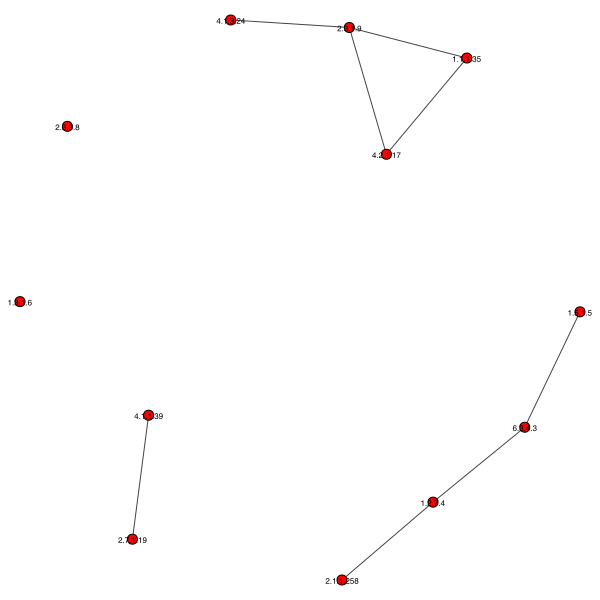

In [251]:

dataset_complete = dataset_carbon_n_key_genes #.dropna(axis=1, how='any') #because we have some missing data
#dataset_complete.index.name = None


correlation_matrix = dataset_complete.T.corr(method='spearman')
correlation_matrix[correlation_matrix < 0.4] = 0



# Create the graph from the matrix
bac_cor_ig = ig.Graph.Adjacency((correlation_matrix.values > 0).tolist(), mode="undirected")
bac_cor_ig.es['weight'] = correlation_matrix.values[correlation_matrix.values > 0]

# Simplify the graph to remove loops and multiple edges
bac_cor_ig = bac_cor_ig.simplify()

# Plot the graph
random.seed(200)
#layout = bac_cor_ig.layout_sugiyama()
layout = bac_cor_ig.layout_kamada_kawai() #g spring embedded
#layout = bac_cor_ig.layout_reingold_tilford()
ig.plot(bac_cor_ig, layout=layout, vertex_size=10, bbox=(600, 600), vertex_label=correlation_matrix.index, vertex_label_size=8, target="graph_plot.pdf")
#ig.plot(bac_cor_ig, vertex_size=10, bbox=(600, 600), vertex_label=correlation_matrix.index, vertex_label_size=8, target="graph_plot.pdf")



In [252]:
print(ec_c_fixation_df.pathway.unique())
ec_c_fixation_df['pathway'].replace({"3HBC": "HB", "DCHB": "HPHB_DCHB", "HPHB": "HPHB_DCHB"}, inplace=True)
print(ec_c_fixation_df.pathway.unique())


['3HBC' 'CBB' 'DCHB' 'HPHB' 'rTCA' 'WL']
['HB' 'CBB' 'HPHB_DCHB' 'rTCA' 'WL']


/var/folders/xd/tzd66fkj5s5676432q_qccqr0000gn/T/ipykernel_72832/1560838535.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  ec_c_fixation_df['pathway'].replace({"3HBC": "HB", "DCHB": "HPHB_DCHB", "HPHB": "HPHB_DCHB"}, inplace=True)
/var/folders/xd/tzd66fkj5s5676432q_qccqr0000gn/T/ipykernel_72832/1560838535.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-vi

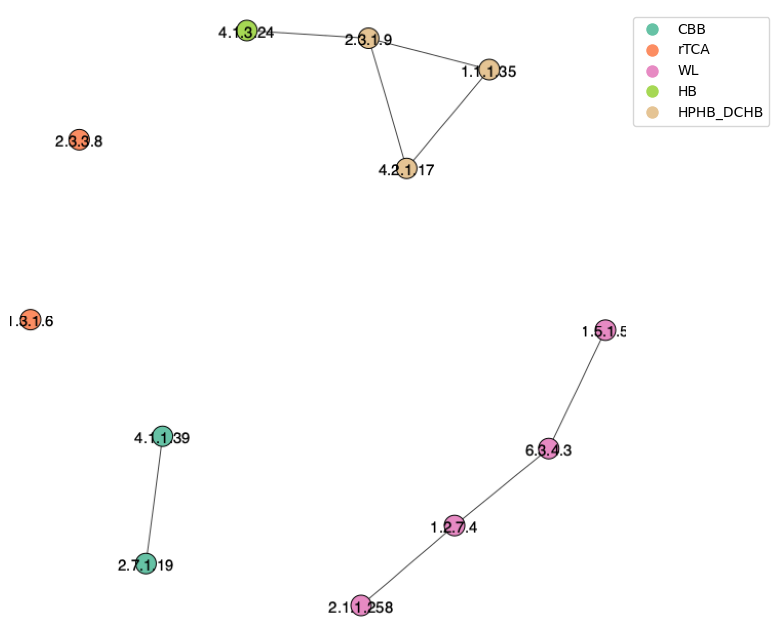

In [253]:

# Create a dictionary mapping EC numbers to pathways
ec_to_pathways = ec_c_fixation_df.groupby('EC')['pathway'].apply(list).to_dict()

# Define the list of possible pathways
#possible_pathways = ['3HBC', 'C1', 'C4', 'CAM', 'CBB', 'DCHB', 'Gluconeogenesis',
 #                    'Glycolysis', 'HPHB', 'InrTCA', 'Methanogenesis', 'PPP', 'rTCA',
 #                    'TCA', 'WL']
possible_pathways = ['CBB', 'rTCA', 'WL', 'HB', 'HPHB_DCHB']

# Use a specific colormap for distinct colors
cmap = plt.get_cmap('Set2')
color_map = {pathway: cmap(i / len(possible_pathways)) for i, pathway in enumerate(possible_pathways)}


# Function to mix colors if an EC number is associated with multiple pathways
def mix_colors(colors):
    return tuple(sum(x) / len(x) for x in zip(*colors))

# Assign colors to vertices based on their associated pathways
vertex_colors = []
for ec in correlation_matrix.index:
    if ec in ec_to_pathways:
        pathways = ec_to_pathways[ec]
        if len(pathways) > 1:
            mixed_color = mix_colors([color_map[path] for path in pathways])
            vertex_colors.append(mcolors.to_hex(mixed_color))
        else:
            vertex_colors.append(mcolors.to_hex(color_map[pathways[0]]))
    else:
        vertex_colors.append("white")  # Default to black if no pathway is found

# Set the vertex colors
bac_cor_ig.vs['color'] = vertex_colors

random.seed(2)
# Plot using the explicit layout
ig.plot(
    bac_cor_ig, 
    layout=layout, 
    vertex_size=20, 
    bbox=(600, 600), 
    vertex_label=correlation_matrix.index, 
    vertex_label_size=15, 
    target="/tmp/graph_plot.png"  # Save plot to this path
)

# Load the graph plot image
graph_img = Image.open("/tmp/graph_plot.png")

# Plot the graph image and the legend together
fig, ax = plt.subplots(figsize=(8, 8))
ax.imshow(graph_img)
ax.axis('off')  # Turn off the axis

# Create a legend using matplotlib
legend_elements = [Line2D([0], [0], marker='o', color='w', label=pathway, 
                          markerfacecolor=mcolors.to_hex(color_map[pathway]), markersize=10)
                   for pathway in possible_pathways]

# Add the legend
ax.legend(handles=legend_elements, loc='upper left', bbox_to_anchor=(1, 1))

#plt.savefig("graph_with_legend.pdf", format="pdf")

plt.show()


## Testing representative genes against the environmental parameters

prk = "2.7.1.19"
rbc = "4.1.1.39"
acly = "2.3.3.8"
codh = "1.2.7.4"
fdh = "1.17.1.10"
mcr = "2.8.4.1"

In [28]:
# Load the environmental data
envdata = pd.read_csv("env.csv", index_col="rowname")



In [29]:
# Check if all column names of ecdata_n are in the index of envdata
missing_in_envdata = [col for col in ecdata_n.columns if col not in envdata.index]
if missing_in_envdata:
    print("Columns in ecdata_n not in envdata index:", missing_in_envdata)
else:
    print("All columns of ecdata_n are present in envdata index.")

# Check which indexes from envdata are not in the column names of ecdata_n
missing_in_ecdata_n = [idx for idx in envdata.index if idx not in ecdata_n.columns]
if missing_in_ecdata_n:
    print("Indexes in envdata not in ecdata_n columns:", missing_in_ecdata_n)
else:
    print("All indexes of envdata are present in ecdata_n columns.")


All columns of ecdata_n are present in envdata index.
Indexes in envdata not in ecdata_n columns: ['ac190614s', 'br1_190716s', 'br2_190717s', 'ep190616s', 'gu190718f', 'sa190716', 'sg190719f', 'CF210924F', 'CG211015F', 'FE211015S', 'GA211029F', 'GA211029S', 'LS211029F', 'LS211029S', 'ML210924F', 'PI210924F', 'PI210924S', 'SI2210715S', 'SP210924F', 'VR211015S', 'GN_2_F', 'HV_1_F', 'SAMD00080625', 'SAMN05449942', 'SAMN05449943', 'SAMN05449944', 'SAMN05518182', 'SAMN06267146', 'SAMN06562582', 'SAMN06706385', 'SAMN06706403', 'SAMN10130915']


I want to create 2 datasets: gendata and envdata, that will allow to evaluate the co-occurence of CFPs with 1. other ECs 2. env parameters

In [271]:
#DEFINE WHICH OPERATION YOU WANT TO PERFORM ON THE CLIQUES
operation = 'sum'

#DEFINE WHICH DATASET (AND THERBY WHICH NORMALIZATION) YOU  WANT TO WORK WITH
dataset = ecdata_n_rpo
gendata = dataset.transpose()

# perform the operation of each clique in a new col 
gendata[f'{operation}_CBB'] = getattr(gendata[CBB.index.tolist()], operation)(axis=1)
gendata[f'{operation}_CBB_2'] = getattr(gendata[CBB_2.index.tolist()], operation)(axis=1)
gendata[f'{operation}_CBB_3'] = getattr(gendata[CBB_3.index.tolist()], operation)(axis=1)
gendata[f'{operation}_rTCA'] = getattr(gendata[rTCA.index.tolist()], operation)(axis=1)
gendata[f'{operation}_rTCA_2'] = getattr(gendata[rTCA_2.index.tolist()], operation)(axis=1)
gendata[f'{operation}_WL'] = getattr(gendata[WL.index.tolist()], operation)(axis=1)
gendata[f'{operation}_WL_2'] = getattr(gendata[WL_2.index.tolist()], operation)(axis=1)
gendata[f'{operation}_HB'] = getattr(gendata[HB.index.tolist()], operation)(axis=1)
gendata[f'{operation}_HB_2'] = getattr(gendata[HB_2.index.tolist()], operation)(axis=1)
gendata[f'{operation}_HB_3'] = getattr(gendata[HB_3.index.tolist()], operation)(axis=1)
gendata[f'{operation}_HPHB_DCHB'] = getattr(gendata[HPHB_DCHB.index.tolist()], operation)(axis=1)
gendata[f'{operation}_HPHB_DCHB_2'] = getattr(gendata[HPHB_DCHB_2.index.tolist()], operation)(axis=1)


# Merge with envdata on their common index
envdata = envdata.merge(gendata, left_index=True, right_index=True)

#Once you have calcutated these indicators, remove again all the EC numbers from envdata
envdata = envdata.drop(columns=dataset.transpose().columns)

In [284]:
envdata

,campaign,name,biosample,site_id,database,study_group,latitude,longitude,sample_name,Read_count_post_fastp,...,sum_CBB_3,sum_rTCA,sum_rTCA_2,sum_WL,sum_WL_2,sum_HB,sum_HB_2,sum_HB_3,sum_HPHB_DCHB,sum_HPHB_DCHB_2
AO100224_S,ARG19,AO100224_S,ARG19AOS,AO,private,57.0,-24.182136,-66.674029,AO,5779408,...,0.093338,0.004817,0.106698,0.141143,0.147323,0.023175,0.023175,0.031355,0.199582,0.204217
AO190224_F,ARG19,AO190224_F,ARG19AOF,AO,private,57.0,-24.182136,-66.674029,AO,10325449,...,0.235825,0.019599,0.120277,0.068939,0.074448,0.008873,0.008873,0.011994,0.116133,0.117352
BJ190227_F,ARG19,BJ190227_F,ARG19BJF,BJ,private,57.0,-25.743034,-67.823245,BJ,11176868,...,0.208201,0.000063,0.150227,0.009001,0.017411,0.000365,0.000378,0.000541,0.013710,0.013861
BJ190227_S,ARG19,BJ190227_S,ARG19BJS,BJ,private,57.0,-25.743034,-67.823245,BJ,8409827,...,0.137117,0.000681,0.159364,0.158456,0.162997,0.005857,0.006129,0.008354,0.185653,0.193780
GA190226_F,ARG19,GA190226_F,ARG19GAF,GA,private,57.0,-25.825416,-66.922496,GA,3219530,...,0.059659,0.000278,0.042395,0.055273,0.078246,0.000905,0.000905,0.001462,0.105186,0.105674
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMN14653553,NCBI,SAMN14653553,SAMN14653553,NaN,SRA,24.0,10.290599,-84.972435,SLS,6778135,...,0.021780,0.003899,0.048878,0.182867,0.184128,0.000630,0.000945,0.003348,0.111186,0.153171
SAMN14653554,NCBI,SAMN14653554,SAMN14653554,NaN,SRA,24.0,10.301239,-85.610549,SIF,16863310,...,0.216419,0.000516,0.152763,0.016780,0.027983,0.003231,0.003255,0.004177,0.481138,0.482366
SAMN14653555,NCBI,SAMN14653555,SAMN14653555,NaN,SRA,24.0,10.301239,-85.610549,SIS,27477843,...,0.037172,0.005725,0.080105,0.194103,0.206141,0.002927,0.003386,0.005208,0.170626,0.202391
SAMN14653556,NCBI,SAMN14653556,SAMN14653556,NaN,SRA,24.0,10.366486,-84.381208,TCF,16890515,...,0.054878,0.014621,0.135523,0.073449,0.083860,0.007441,0.008110,0.011325,0.207568,0.211012


In [272]:
# For gendata I want to exclude all C-related genes (to see if totally different genes can correlate with CFPs) 
# (but i could try to include at least ones that are C-related but not CFPs...)
gendata = gendata.drop(columns=ec_list, errors='ignore')


test: plot clique X against a parameter

/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


<Figure size 350x300 with 0 Axes>

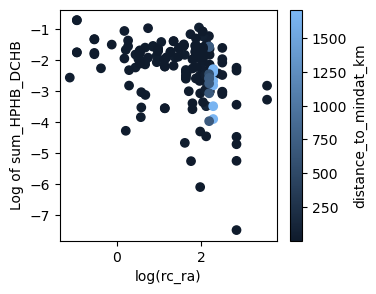

Spearman correlation coefficient (rho): -0.3753829774916602
P-value: 2.843758607977524e-07


In [273]:
plt.figure(figsize=(3.5, 3))  

clique = f"{operation}_HPHB_DCHB"
param = "rc_ra"

cmap = mcolors.LinearSegmentedColormap.from_list(
    'custom_blues',
    ['#0f1b2cff', '#7cb8f6ff']
)

# Remove rows with NaN values in the columns used
clean_data = envdata[[f'{param}', f'{clique}']].dropna()

# Scatter plot with color based on 'distance_to_mindat_km'
plt.figure(figsize=(3.5, 3))
scatter = plt.scatter(np.log(clean_data[f'{param}']), np.log(clean_data[f'{clique}']), 
                      c=envdata.loc[clean_data.index, 'distance_to_mindat_km'], cmap=cmap)

# Add colorbar
plt.colorbar(scatter, label='distance_to_mindat_km')

plt.xlabel(f'log({param})')
plt.ylabel(f'Log of {clique}')
plt.show()

# Calculate Spearman correlation
rho, p_value = spearmanr(np.log(clean_data[f'{param}']), np.log(clean_data[f'{clique}']))

print(f"Spearman correlation coefficient (rho): {rho}")
print(f"P-value: {p_value}")


In [274]:
envdata

,campaign,name,biosample,site_id,database,study_group,latitude,longitude,sample_name,Read_count_post_fastp,...,sum_CBB_3,sum_rTCA,sum_rTCA_2,sum_WL,sum_WL_2,sum_HB,sum_HB_2,sum_HB_3,sum_HPHB_DCHB,sum_HPHB_DCHB_2
AO100224_S,ARG19,AO100224_S,ARG19AOS,AO,private,57.0,-24.182136,-66.674029,AO,5779408,...,0.093338,0.004817,0.106698,0.141143,0.147323,0.023175,0.023175,0.031355,0.199582,0.204217
AO190224_F,ARG19,AO190224_F,ARG19AOF,AO,private,57.0,-24.182136,-66.674029,AO,10325449,...,0.235825,0.019599,0.120277,0.068939,0.074448,0.008873,0.008873,0.011994,0.116133,0.117352
BJ190227_F,ARG19,BJ190227_F,ARG19BJF,BJ,private,57.0,-25.743034,-67.823245,BJ,11176868,...,0.208201,0.000063,0.150227,0.009001,0.017411,0.000365,0.000378,0.000541,0.013710,0.013861
BJ190227_S,ARG19,BJ190227_S,ARG19BJS,BJ,private,57.0,-25.743034,-67.823245,BJ,8409827,...,0.137117,0.000681,0.159364,0.158456,0.162997,0.005857,0.006129,0.008354,0.185653,0.193780
GA190226_F,ARG19,GA190226_F,ARG19GAF,GA,private,57.0,-25.825416,-66.922496,GA,3219530,...,0.059659,0.000278,0.042395,0.055273,0.078246,0.000905,0.000905,0.001462,0.105186,0.105674
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMN14653553,NCBI,SAMN14653553,SAMN14653553,NaN,SRA,24.0,10.290599,-84.972435,SLS,6778135,...,0.021780,0.003899,0.048878,0.182867,0.184128,0.000630,0.000945,0.003348,0.111186,0.153171
SAMN14653554,NCBI,SAMN14653554,SAMN14653554,NaN,SRA,24.0,10.301239,-85.610549,SIF,16863310,...,0.216419,0.000516,0.152763,0.016780,0.027983,0.003231,0.003255,0.004177,0.481138,0.482366
SAMN14653555,NCBI,SAMN14653555,SAMN14653555,NaN,SRA,24.0,10.301239,-85.610549,SIS,27477843,...,0.037172,0.005725,0.080105,0.194103,0.206141,0.002927,0.003386,0.005208,0.170626,0.202391
SAMN14653556,NCBI,SAMN14653556,SAMN14653556,NaN,SRA,24.0,10.366486,-84.381208,TCF,16890515,...,0.054878,0.014621,0.135523,0.073449,0.083860,0.007441,0.008110,0.011325,0.207568,0.211012


### Test each clique against each other (first with log transformation... so need to remove zeros first to avoid inf values in the log transformation)

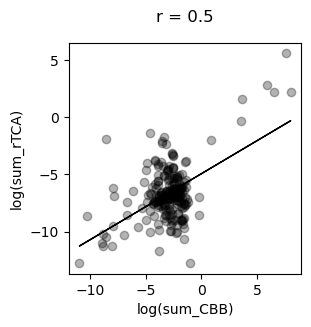

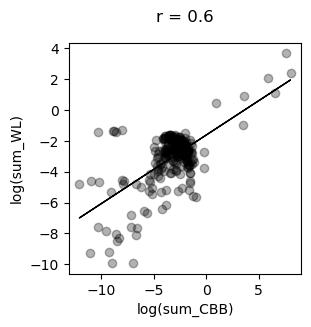

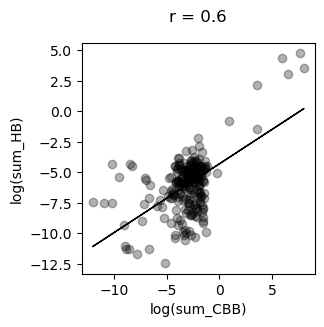

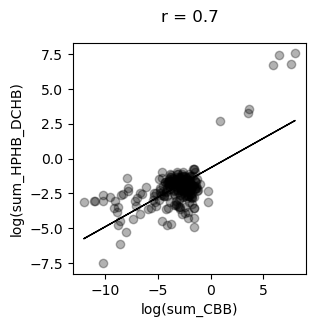

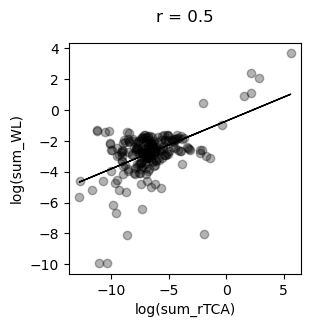

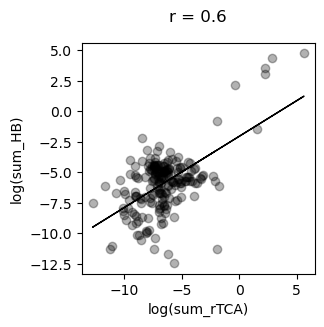

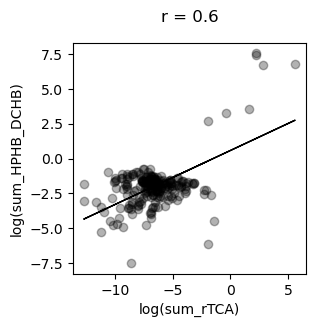

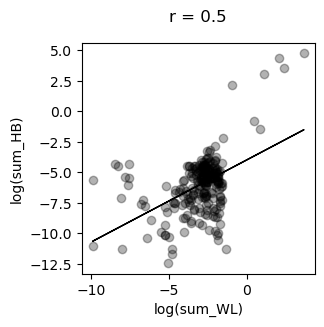

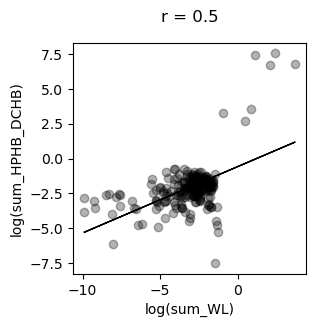

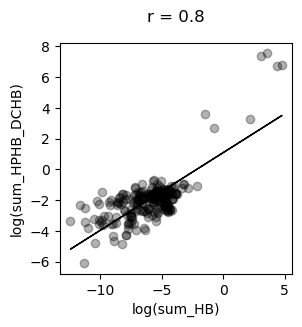

In [275]:
# List of parameters to plot against each other
parameters = [f'{operation}_CBB', f'{operation}_rTCA', f'{operation}_WL', f'{operation}_HB', f'{operation}_HPHB_DCHB']

# Loop over each pair of parameters
for x_param, y_param in itertools.combinations(parameters, 2):
    x = np.log(envdata[x_param].replace(0, np.nan)).dropna()
    y = np.log(envdata[y_param].replace(0, np.nan)).dropna()
    
    # Keep only overlapping data points
    x, y = x.align(y, join='inner')
    
    # Scatter plot
    plt.figure(figsize=(3, 3))
    scatter = plt.scatter(x, y, c="black", alpha=.3)
    plt.xlabel(f'log({x_param})')
    plt.ylabel(f'log({y_param})')
    
    # Calculate Pearson correlation
    r, _ = pearsonr(x, y)
    
    # Display r above the plot
    plt.title(f'r = {r:.1f}', pad=15)
    
    # Plot regression line
    slope, intercept, _, _, _ = linregress(x, y)
    plt.plot(x, slope * x + intercept, color='black', linewidth=1)
    
    plt.show()


### Test each clique against each other (now without log transformation... so I dont need to remove zeros first to avoid inf values in the log transformation)

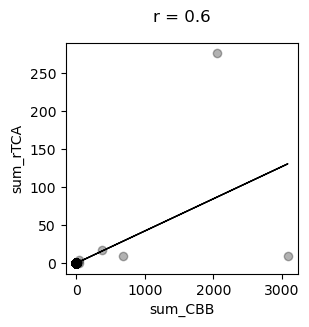

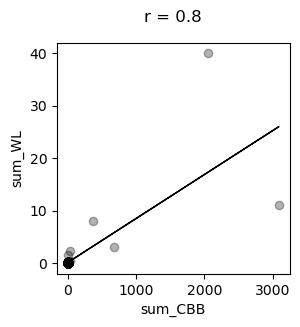

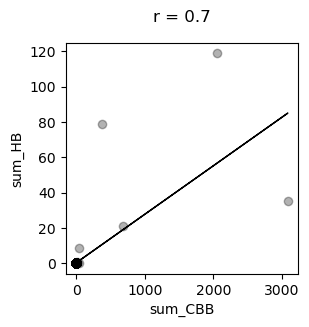

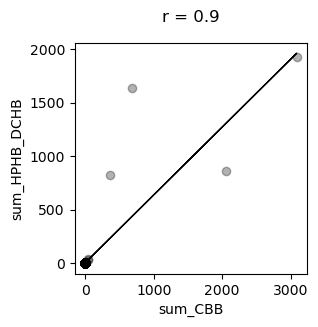

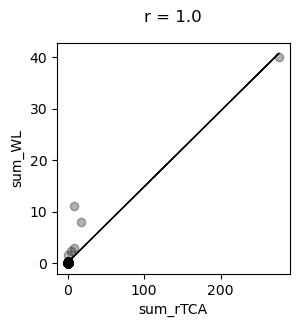

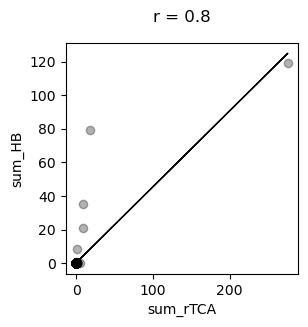

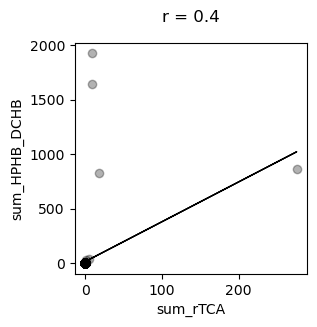

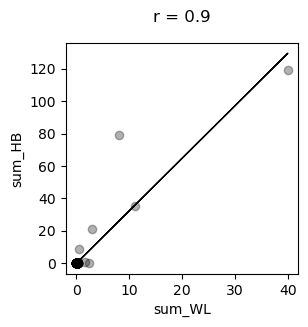

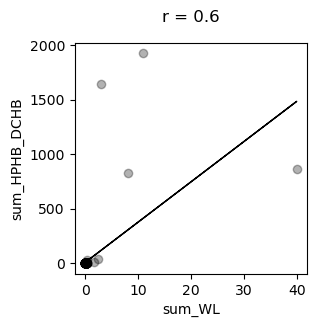

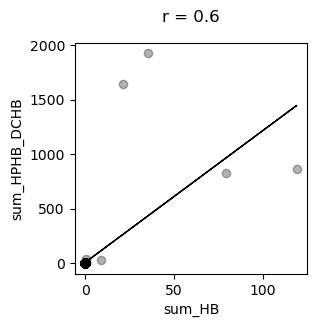

In [281]:
# List of parameters to plot against each other
parameters = [f'{operation}_CBB', f'{operation}_rTCA', f'{operation}_WL', f'{operation}_HB', f'{operation}_HPHB_DCHB']

# Loop over each pair of parameters
for x_param, y_param in itertools.combinations(parameters, 2):

    x = envdata[x_param]
    y = envdata[y_param]
    
    # Scatter plot
    plt.figure(figsize=(3, 3))
    scatter = plt.scatter(x, y, c="black", alpha=.3)
    plt.xlabel(f'{x_param}')
    plt.ylabel(f'{y_param}')
    
    # Calculate Pearson correlation
    r, _ = pearsonr(x, y)
    
    # Display r above the plot
    plt.title(f'r = {r:.1f}', pad=15)
    
    # Plot regression line
    slope, intercept, _, _, _ = linregress(x, y)
    plt.plot(x, slope * x + intercept, color='black', linewidth=1)
    
    plt.show()




### Remove, from these 2 datasets, columns with all NaN or only one unique value

In [282]:

# Columns with all NaN or only one unique value
columns_to_remove_env = envdata.columns[envdata.isna().all() | (envdata.nunique() <= 1)]
columns_to_remove_gen = gendata.columns[gendata.isna().all() | (gendata.nunique() <= 1)]

# Print the column names that will be removed
print("Removed columns in envdata:", columns_to_remove_env.tolist())
print("Removed columns in gendata:", columns_to_remove_gen.tolist())

# Now remove the columns
envdata = envdata.drop(columns=columns_to_remove_env)
gendata = gendata.drop(columns=columns_to_remove_gen)


Removed columns in envdata: ['Ti_aq', 'Pd_aq', 'Sn_aq', 'Sb_aq', 'Yh_aq', 'gd', 'sc', 'ConShelf', 'Time_rift', 'Water_type', 'iron_proteins']
Removed columns in gendata: ['1.13.12.13', '2.4.99.6', '2.7.7.6', '2.7.99.1', '3.4.24.83', '4.4.1.26', '5.4.3.1', '6.3.2.n3']


Test a clique vs env parameters

/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

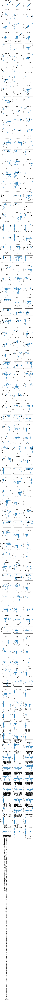

In [283]:
from scipy.stats import linregress

clique = f"{operation}_CBB"

# Store the correlation values and column names separately for numeric and categorical data
numeric_correlations = []
categorical_correlations = []

# Calculate correlations for each column
for column in envdata.columns:
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{clique}'])
            
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            numeric_correlations.append((column, corr))
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{clique}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            categorical_correlations.append((column, corr))

# Sort both numeric and categorical columns by absolute value of correlations
sorted_numeric = sorted(numeric_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_categorical = sorted(categorical_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_columns = sorted_numeric + sorted_categorical

# Plotting
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)
axes = axes.flatten()

# Plot each column based on the sorted order with regression
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{clique}'])
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'log({column})')
            ax.set_ylabel(f'log({clique})')
            ax.set_title(f'Pearson: {corr:.2f}')
            
            # Calculate and plot regression line
            slope, intercept, _, _, _ = linregress(x, y)
            ax.plot(x, slope * x + intercept, color='black', linewidth=1)
        else:
            ax.set_title('No valid data')
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{clique}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(f'log({clique})')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
            
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


In [213]:
from scipy.stats import linregress

clique = f"{operation}_CBB"

# Store the correlation values and column names separately for numeric and categorical data
numeric_correlations = []
categorical_correlations = []

# Calculate correlations for each column
for column in envdata.columns:
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[valid_data[column].notna() & valid_data[f'{clique}'].notna()]
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            numeric_correlations.append((column, corr))
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            categorical_correlations.append((column, corr))

# Sort both numeric and categorical columns by absolute value of correlations
sorted_numeric = sorted(numeric_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_categorical = sorted(categorical_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_columns = sorted_numeric + sorted_categorical

# Plotting
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)
axes = axes.flatten()

# Plot each column based on the sorted order with regression
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[valid_data[column].notna() & valid_data[f'{clique}'].notna()]
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(clique)
            ax.set_title(f'Pearson: {corr:.2f}')
            
            # Calculate and plot regression line
            slope, intercept, _, _, _ = linregress(x, y)
            ax.plot(x, slope * x + intercept, color='black', linewidth=1)
        else:
            ax.set_title('No valid data')
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(clique)
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
            
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


ValueError: `x` and `y` must have length at least 2.

In [215]:
from scipy.stats import linregress

clique = f"{operation}_CBB"

# Store the correlation values and column names separately for numeric and categorical data
numeric_correlations = []
categorical_correlations = []

# Calculate correlations for each column
for column in envdata.columns:
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            numeric_correlations.append((column, corr))
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
        
        if not np.isnan(corr):
            categorical_correlations.append((column, corr))

# Sort both numeric and categorical columns by absolute value of correlations
sorted_numeric = sorted(numeric_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_categorical = sorted(categorical_correlations, key=lambda x: abs(x[1]), reverse=True)
sorted_columns = sorted_numeric + sorted_categorical

# Plotting
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)
axes = axes.flatten()

# Plot each column based on the sorted order with regression
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    
    if pd.api.types.is_numeric_dtype(envdata[column]):
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(clique)
            ax.set_title(f'Pearson: {corr:.2f}')
            
            # Calculate and plot regression line
            slope, intercept, _, _, _ = linregress(x, y)
            ax.plot(x, slope * x + intercept, color='black', linewidth=1)
        else:
            ax.set_title('No valid data')
    
    else:
        valid_data = envdata.dropna(subset=[column, f'{clique}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(clique)
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
            
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


ValueError: `x` and `y` must have length at least 2.

Test a clique vs gen parameters (only first XX plots)

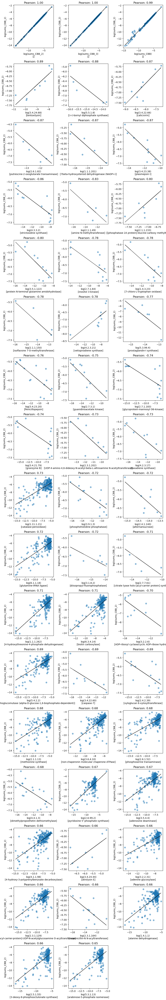

In [91]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr, linregress

clique = f"{operation}_CBB_2"
Num_plots = 50  # number of plots to show

# Load enzyme names
ec_df = pd.read_csv("full_ec_list.csv")
ec_dict = ec_df.set_index('ec')['name'].to_dict()

# Store the correlation values and column names
correlations = []

# Calculate correlations for each column
for column in gendata.columns:
    if pd.api.types.is_numeric_dtype(gendata[column]):
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{clique}'])
            
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
    else:
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points
            x = valid_data[column]
            y = np.log(valid_data[f'{clique}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            # Calculate Spearman correlation
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
    
    if not np.isnan(corr):
        correlations.append((column, corr))

# Sort columns by the absolute value of correlations
sorted_columns = sorted(correlations, key=lambda x: abs(x[1]), reverse=True)[:Num_plots] 

# Set up subplots
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)
axes = axes.flatten()

# Plot each column based on the sorted order
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    enzyme_name = ec_dict.get(column, "")
    
    if pd.api.types.is_numeric_dtype(gendata[column]):
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points for plotting
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{clique}'])
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'log({column})\n[{enzyme_name}]')
            ax.set_ylabel(f'log({clique})')
            ax.set_title(f'Pearson: {corr:.2f}')
            
            # Calculate and plot regression line
            slope, intercept, _, _, _ = linregress(x, y)
            ax.plot(x, slope * x + intercept, color='black', linewidth=1)
        else:
            ax.set_title('No valid data')
    else:
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points for plotting
            x = valid_data[column]
            y = np.log(valid_data[f'{clique}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(f'{column} [{enzyme_name}]')
            ax.set_ylabel(f'log({clique})')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
            
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


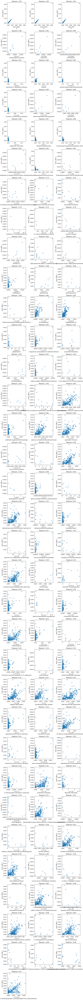

In [92]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, spearmanr

clique = f"{operation}_CBB_2"
Num_plots = 100  # number of plots to show

# Load enzyme names
ec_df = pd.read_csv("full_ec_list.csv")
ec_dict = ec_df.set_index('ec')['name'].to_dict()

# Store the correlation values and column names
correlations = []

# Calculate correlations for each column
for column in gendata.columns:
    if pd.api.types.is_numeric_dtype(gendata[column]):
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            if x.std() != 0 and y.std() != 0:
                corr, _ = pearsonr(x, y)
            else:
                corr = float('nan')
        else:
            corr = float('nan')
    else:
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            # Calculate Spearman correlation
            corr, _ = spearmanr(numeric_categories, y)
        else:
            corr = float('nan')
    
    if not np.isnan(corr):
        correlations.append((column, corr))

# Sort columns by the absolute value of correlations
sorted_columns = sorted(correlations, key=lambda x: abs(x[1]), reverse=True)[:Num_plots] 

# Set up subplots
n_rows = int(np.ceil(len(sorted_columns) / 3))
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)
axes = axes.flatten()

# Plot each column based on the sorted order
for i, (column, corr) in enumerate(sorted_columns):
    ax = axes[i]
    enzyme_name = ec_dict.get(column, "")
    
    if pd.api.types.is_numeric_dtype(gendata[column]):
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{clique}'] > 0)]
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points for plotting
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'{column}\n[{enzyme_name}]')
            ax.set_ylabel(f'{clique}')
            ax.set_title(f'Pearson: {corr:.2f}')
        else:
            ax.set_title('No valid data')
    else:
        valid_data = gendata.dropna(subset=[column, f'{clique}'])
        
        if len(valid_data) >= 5:  # Ensure at least 5 valid points for plotting
            x = valid_data[column]
            y = valid_data[f'{clique}']
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(f'{column} [{enzyme_name}]')
            ax.set_ylabel(f'{clique}')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            ax.set_title(f'Spearman: {corr:.2f}')
        else:
            ax.set_title('No valid data')

# Turn off unused subplots
for j in range(len(sorted_columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


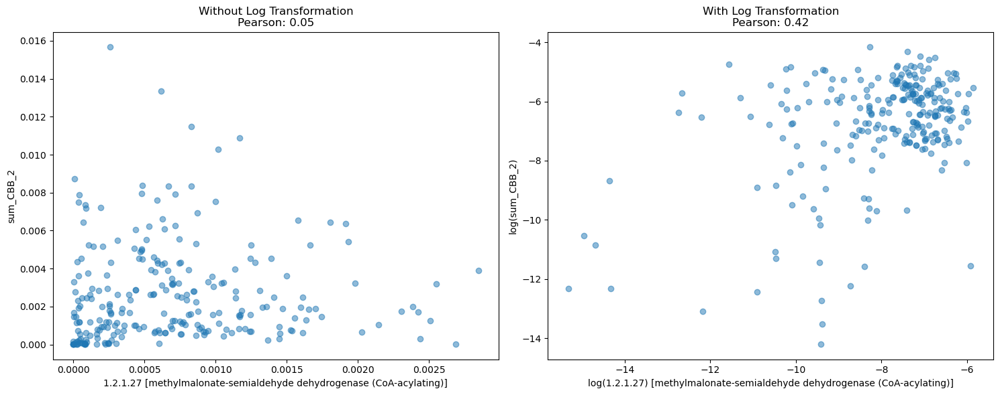

In [161]:
#TEST WITH ONE GENE
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

clique = f"{operation}_CBB_2"
column_to_plot = '1.2.1.27'

# Load enzyme names
ec_df = pd.read_csv("full_ec_list.csv")
ec_dict = ec_df.set_index('ec')['name'].to_dict()

# Prepare valid data
valid_data = gendata.dropna(subset=[column_to_plot, clique])
valid_data = valid_data[(valid_data[column_to_plot] > 0) & (valid_data[clique] > 0)]

# Ensure there are enough valid points
if len(valid_data) >= 5:
    # Without log transformation
    x_no_log = valid_data[column_to_plot]
    y_no_log = valid_data[clique]
    corr_no_log, _ = pearsonr(x_no_log, y_no_log)

    # With log transformation
    x_log = np.log(valid_data[column_to_plot])
    y_log = np.log(valid_data[clique])
    corr_log, _ = pearsonr(x_log, y_log)

    # Set up subplots
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))

    # Plot without log transformation
    ax1 = axes[0]
    ax1.scatter(x_no_log, y_no_log, alpha=0.5)
    ax1.set_xlabel(f'{column_to_plot} [{ec_dict.get(column_to_plot, "")}]')
    ax1.set_ylabel(f'{clique}')
    ax1.set_title(f'Without Log Transformation\nPearson: {corr_no_log:.2f}')

    # Plot with log transformation
    ax2 = axes[1]
    ax2.scatter(x_log, y_log, alpha=0.5)
    ax2.set_xlabel(f'log({column_to_plot}) [{ec_dict.get(column_to_plot, "")}]')
    ax2.set_ylabel(f'log({clique})')
    ax2.set_title(f'With Log Transformation\nPearson: {corr_log:.2f}')

    plt.tight_layout()
    plt.show()
else:
    print("Not enough valid data points for plotting.")


/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

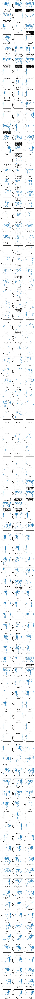

In [103]:
#### THIS ONE IS DONE BY CHATGPT TO SOLVE PROBLEM WWITH  PEARSON (but small risk it deleted some values im not sure)

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

plt.subplots_adjust(left=0.1,  right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values and filter for positive values to apply log
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        valid_data = valid_data[(valid_data[column] > 0) & (valid_data[f'{gene}'] > 0)]
        
        if not valid_data.empty:
            x = np.log(valid_data[column])
            y = np.log(valid_data[f'{gene}'])
            
            # Plot numeric columns
            ax.scatter(x, y, alpha=0.5)
            ax.set_xlabel(f'log({column})')
            ax.set_ylabel(f'log({gene})')
            
            # Check if x or y are constant (standard deviation == 0)
            if x.std() == 0 or y.std() == 0:
                corr = float('nan')  # Pearson is not defined for constant values
            else:
                # Calculate Pearson correlation coefficient
                corr, _ = pearsonr(x, y)
            
            ax.set_title(f'Pearson: {corr:.2f}')
        else:
            ax.set_title('No valid data')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        
        if not valid_data.empty:
            x = valid_data[column]
            y = np.log(valid_data[f'{gene}'])
            
            unique_categories = x.dropna().unique()
            category_map = {category: idx for idx, category in enumerate(unique_categories)}
            numeric_categories = x.map(category_map)
            
            # Plot categorical columns
            ax.scatter(numeric_categories, y, alpha=0.5)
            ax.set_xlabel(column)
            ax.set_ylabel(f'log({gene})')
            ax.set_xticks(range(len(unique_categories)))
            ax.set_xticklabels(unique_categories, rotation=90)
            
            # Calculate and display Spearman correlation coefficient
            corr, _ = spearmanr(numeric_categories, y)
            ax.set_title(f'Spearman: {corr:.2f}')
        else:
            ax.set_title('No valid data')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    if j >= len(envdata.columns):
        axes[j].axis('off')

plt.tight_layout()
plt.show()


/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/Users/benoitdepins/miniconda3/envs/subcarb/lib/python3.12/site-packages/pandas/core/arraylike.py:399: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufun

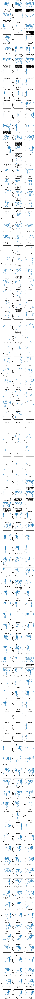

In [100]:
prk = "2.7.1.19"
rbc = "4.1.1.39"
acly = "2.3.3.8"
codh = "1.2.7.4"
fdh = "1.17.1.10"
mcr = "2.8.4.1"

gene = prk

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

plt.subplots_adjust(left=0.1,  right=0.9, top=0.9, bottom=0.1, hspace=0.5, wspace=0.4)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        x = np.log(valid_data[column])
        y = np.log(valid_data[f'{gene}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(f'log({column})')
        ax.set_ylabel(f'log({gene})')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'{gene}'])
        x = valid_data[column]
        y = np.log(valid_data[f'{gene}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log({gene})')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


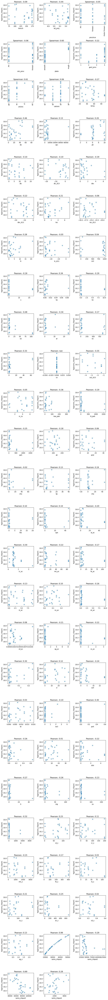

In [135]:
clique = 'clique1'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


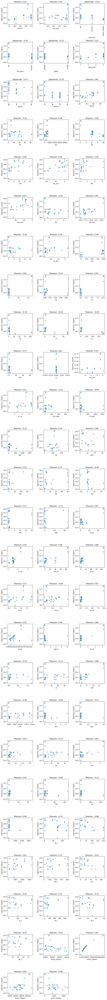

In [136]:
clique = 'clique2'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


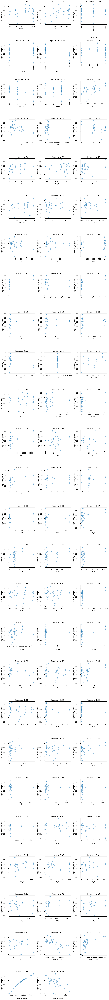

In [137]:
clique = 'clique3'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()


KeyError: ['sums_clique4']

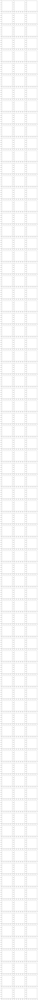

In [32]:
clique = 'clique4'

# Number of rows needed
n_rows = int(np.ceil(len(envdata.columns) / 3))

# Create subplots
fig, axes = plt.subplots(n_rows, 3, figsize=(10, 3.5 * n_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each column against the log of sums_clique
for i, column in enumerate(envdata.columns):
    ax = axes[i]
    
    # Check if the column is numeric or categorical
    if pd.api.types.is_numeric_dtype(envdata[column]):
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        # Plot numeric columns
        ax.scatter(x, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        
        # Calculate and display Pearson correlation coefficient
        corr, _ = pearsonr(x, y)
        ax.set_title(f'Pearson: {corr:.2f}')
    else:
        # Drop NaN values
        valid_data = envdata.dropna(subset=[column, f'sums_{clique}'])
        x = valid_data[column]
        y = np.log(valid_data[f'sums_{clique}'])
        
        unique_categories = x.dropna().unique()
        category_map = {category: idx for idx, category in enumerate(unique_categories)}
        numeric_categories = x.map(category_map)
        
        # Plot categorical columns
        ax.scatter(numeric_categories, y, alpha=0.5)
        ax.set_xlabel(column)
        ax.set_ylabel(f'log(sums_{clique}')
        ax.set_xticks(range(len(unique_categories)))
        ax.set_xticklabels(unique_categories, rotation=90)
        
        # Calculate and display Spearman correlation coefficient
        corr, _ = spearmanr(numeric_categories, y)
        ax.set_title(f'Spearman: {corr:.2f}')

# Turn off any unused subplots
for j in range(len(envdata.columns), len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()
